<div>
    <p style="font-size: 40px; margin: 5px;"><b>Курсовой проект</b></p>
    <p style="font-size: 20px; margin: 5px;">по теме</p>
    <p style="font-size: 30px; margin: 5px;"><b>«Машинное обучение в задачах повышения качества изображений»</b></p>
</div>

<style>
h1:after,
h2:after,
h3:after,
h4:after {
    position: absolute;
    content: "";
    left: 0;
    top: 0;
    bottom: 0;
    width: 5px;
    border-radius: 5px;
    box-shadow:
        inset 0 1px 1px rgba(0,0,0,0.5),
        0 1px 1px rgba(255,255,255,0.3);
}
 
h1:after { background: #aaf683; left: 0; padding: 0 0 0 10px;}
h2:after { background: #aaf683; left: 10px; padding: 0 0 0 5px;}
h3:after { background: #aaf683; left: 20px;}
h4:after { background: #aaf683; left: 30px;}
 
h1 {
    font-size: 36px;
    line-height: 40px;
    padding: 0 0 0 25px;
    margin: 1em 0 .6em 0;
    font-weight: normal;
    font-family: 'Hammersmith One', sans-serif;
    text-shadow: 1px 1px 2px rgba(0,0,0,0.4);
    position: relative;
}
 
h2 {
    margin: 1em 0 .6em 0;
    padding: 0 0 0 35px;
    font-weight: normal;
    font-family: 'Hammersmith One', sans-serif;
    text-shadow: 1px 1px 2px rgba(0,0,0,0.4);
    position: relative;
    font-size: 30px;
    line-height: 36px;
}
 
h3 {
    margin: 1em 0 .6em 0;
    padding: 0 0 0 40px;
    font-weight: normal;
    font-family: 'Hammersmith One', sans-serif;
    text-shadow: 1px 1px 2px rgba(0,0,0,0.4);
    position: relative;
    font-size: 24px;
    line-height: 32px;
    font-family: 'Questrial', sans-serif;
}
 
h4 {
    margin: 1em 0 .6em 0;
    padding: 0 0 0 50px;
    font-weight: normal;
    font-family: 'Hammersmith One', sans-serif;
    text-shadow: 1px 1px 2px rgba(0,0,0,0.4);
    position: relative;
    font-size: 18px;
    line-height: 28px;
    font-family: 'Questrial', sans-serif;
}
</style>

# <h1>Оглавление</h1> <a class="anchor" id="toc"></a>
* [Введение](#introduction)
* [Теоретическая справка](#theory)
    * [Методы понижения качества изображения](#theory_downgrading)
    * [Существующие подходы для решения задачи повышения качества изображений](#theory_methods)
        * [Свёрточные нейронные сети](#theory_methods_cnn)
        * [Генеративные модели](#theory_methods_gan)
    * [Методы оценки схожести изображений](#theory_similarity)
* [Практическая часть](#main)
    * [Сбор и предобработка данных](#main_dataset)
    * [Обучение моделей](#main_train)
        * [Pre-upsampling: SRCNN](#main_train_srcnn)
        * [Post-upsampling: FSRCNN](#main_train_fsrcnn)
        * [GAN: SRGAN](#main_train_srgan)
    * [Итоговое сравнение](#main_comparing)
* [Заключение](#conclusion)
* [Список источников](#references)

<style>
h1:after,
h2:after,
h3:after,
h4:after {
    position: absolute;
    content: "";
    left: 0;
    top: 0;
    bottom: 0;
    width: 5px;
    border-radius: 5px;
    box-shadow:
        inset 0 1px 1px rgba(0,0,0,0.5),
        0 1px 1px rgba(255,255,255,0.3);
}
 
h1:after { background: #aaf683; left: 0; padding: 0 0 0 10px;}
h2:after { background: #aaf683; left: 10px; padding: 0 0 0 5px;}
h3:after { background: #aaf683; left: 20px;}
h4:after { background: #aaf683; left: 30px;}
 
h1 {
    font-size: 36px;
    line-height: 40px;
    padding: 0 0 0 25px;
    margin: 1em 0 .6em 0;
    font-weight: normal;
    
    font-family: 'Hammersmith One', sans-serif;
    text-shadow: 1px 1px 2px rgba(0,0,0,0.4);
    position: relative;
}
 
h2 {
    margin: 1em 0 .6em 0;
    padding: 0 0 0 35px;
    font-weight: normal;
    
    font-family: 'Hammersmith One', sans-serif;
    text-shadow: 1px 1px 2px rgba(0,0,0,0.4);
    position: relative;
    font-size: 30px;
    line-height: 36px;
}
 
h3 {
    margin: 1em 0 .6em 0;
    padding: 0 0 0 40px;
    font-weight: normal;
    
    font-family: 'Hammersmith One', sans-serif;
    text-shadow: 1px 1px 2px rgba(0,0,0,0.4);
    position: relative;
    font-size: 24px;
    line-height: 32px;
    font-family: 'Questrial', sans-serif;
}
 
h4 {
    margin: 1em 0 .6em 0;
    padding: 0 0 0 50px;
    font-weight: normal;
    
    font-family: 'Hammersmith One', sans-serif;
    text-shadow: 1px 1px 2px rgba(0,0,0,0.4);
    position: relative;
    font-size: 18px;
    line-height: 28px;
    font-family: 'Questrial', sans-serif;
}
</style>

# <h1>Введение</h1> <a class="anchor" id="introduction"></a>

В представленной работе решается проблема повышения качества изображений с помощью машинного обучения.

<b>Цель</b>: получить модели для повышения качества изображений

<b>Задачи</b>:
- Анализ методов и моделей для достижения поставленной цели;
- Сбор данных и их предобработка (получение изображений, использование различных методов для понижения качества, подготовка к обучению);
- Обучение нескольких моделей, наиболее подходящих под задачу;
- Сравнение качества моделей на валидационном наборе изображений.

<b>Актуальность</b>: использование достижений машинного обучения помогает человеку в разных сферах, в том числе и обрабатывать изображения. Задача повышения качества фотографий всегда имеет спрос, поэтому использование нейронных сетей вместо ручного дорогостоящего труда имеет преимущество в эффективности и стоимости.

Исходный код работы и веса для моделей представлены на [GitHub]().

<style>
h1:after,
h2:after,
h3:after,
h4:after {
    position: absolute;
    content: "";
    left: 0;
    top: 0;
    bottom: 0;
    width: 5px;
    border-radius: 5px;
    box-shadow:
        inset 0 1px 1px rgba(0,0,0,0.5),
        0 1px 1px rgba(255,255,255,0.3);
}
 
h1:after { background: #aaf683; left: 0; padding: 0 0 0 10px;}
h2:after { background: #aaf683; left: 10px; padding: 0 0 0 5px;}
h3:after { background: #aaf683; left: 20px;}
h4:after { background: #aaf683; left: 30px;}
 
h1 {
    font-size: 36px;
    line-height: 40px;
    padding: 0 0 0 25px;
    margin: 1em 0 .6em 0;
    font-weight: normal;
    
    font-family: 'Hammersmith One', sans-serif;
    text-shadow: 1px 1px 2px rgba(0,0,0,0.4);
    position: relative;
}
 
h2 {
    margin: 1em 0 .6em 0;
    padding: 0 0 0 35px;
    font-weight: normal;
    
    font-family: 'Hammersmith One', sans-serif;
    text-shadow: 1px 1px 2px rgba(0,0,0,0.4);
    position: relative;
    font-size: 30px;
    line-height: 36px;
}
 
h3 {
    margin: 1em 0 .6em 0;
    padding: 0 0 0 40px;
    font-weight: normal;
    
    font-family: 'Hammersmith One', sans-serif;
    text-shadow: 1px 1px 2px rgba(0,0,0,0.4);
    position: relative;
    font-size: 24px;
    line-height: 32px;
    font-family: 'Questrial', sans-serif;
}
 
h4 {
    margin: 1em 0 .6em 0;
    padding: 0 0 0 50px;
    font-weight: normal;
    
    font-family: 'Hammersmith One', sans-serif;
    text-shadow: 1px 1px 2px rgba(0,0,0,0.4);
    position: relative;
    font-size: 18px;
    line-height: 28px;
    font-family: 'Questrial', sans-serif;
}
</style>

# <h1>Теоретическая справка</h1> <a class="anchor" id="theory"></a>

In [1]:
import numpy as np
from PIL import Image
import matplotlib.pyplot as plt
import matplotlib
import datetime as dt

from tqdm import tqdm

matplotlib.rcParams.update({'font.family': 'monospace',
                            'axes.titleweight': 'bold',
                            'axes.titlepad': 12,
                            'axes.titlesize': 16})

<style>
h1:after,
h2:after,
h3:after,
h4:after {
    position: absolute;
    content: "";
    left: 0;
    top: 0;
    bottom: 0;
    width: 5px;
    border-radius: 5px;
    box-shadow:
        inset 0 1px 1px rgba(0,0,0,0.5),
        0 1px 1px rgba(255,255,255,0.3);
}
 
h1:after { background: #aaf683; left: 0; padding: 0 0 0 10px;}
h2:after { background: #aaf683; left: 10px; padding: 0 0 0 5px;}
h3:after { background: #aaf683; left: 20px;}
h4:after { background: #aaf683; left: 30px;}
 
h1 {
    font-size: 36px;
    line-height: 40px;
    padding: 0 0 0 25px;
    margin: 1em 0 .6em 0;
    font-weight: normal;
    
    font-family: 'Hammersmith One', sans-serif;
    text-shadow: 1px 1px 2px rgba(0,0,0,0.4);
    position: relative;
}
 
h2 {
    margin: 1em 0 .6em 0;
    padding: 0 0 0 35px;
    font-weight: normal;
    
    font-family: 'Hammersmith One', sans-serif;
    text-shadow: 1px 1px 2px rgba(0,0,0,0.4);
    position: relative;
    font-size: 30px;
    line-height: 36px;
}
 
h3 {
    margin: 1em 0 .6em 0;
    padding: 0 0 0 40px;
    font-weight: normal;
    
    font-family: 'Hammersmith One', sans-serif;
    text-shadow: 1px 1px 2px rgba(0,0,0,0.4);
    position: relative;
    font-size: 24px;
    line-height: 32px;
    font-family: 'Questrial', sans-serif;
}
 
h4 {
    margin: 1em 0 .6em 0;
    padding: 0 0 0 50px;
    font-weight: normal;
    
    font-family: 'Hammersmith One', sans-serif;
    text-shadow: 1px 1px 2px rgba(0,0,0,0.4);
    position: relative;
    font-size: 18px;
    line-height: 28px;
    font-family: 'Questrial', sans-serif;
}
</style>

## <h2>Методы понижения качества изображения</h2> <a class="anchor" id="theory_downgrading"></a>

Чтобы приступить к повышению качества изображения, для начала стоит разобраться в предпосылках для решения поставленной задачи. Почему вообще получаются изображения низкого качества? Существуют несколько причин, которые представлены ниже. В качестве примера здесь будем использовать календарь с изображением котёнка, так как на нём есть и текст, и мелкие детали.

* <span>Изначально низкое разрешение (а, как следствие, и меньшее наличие полезной информации)</span>

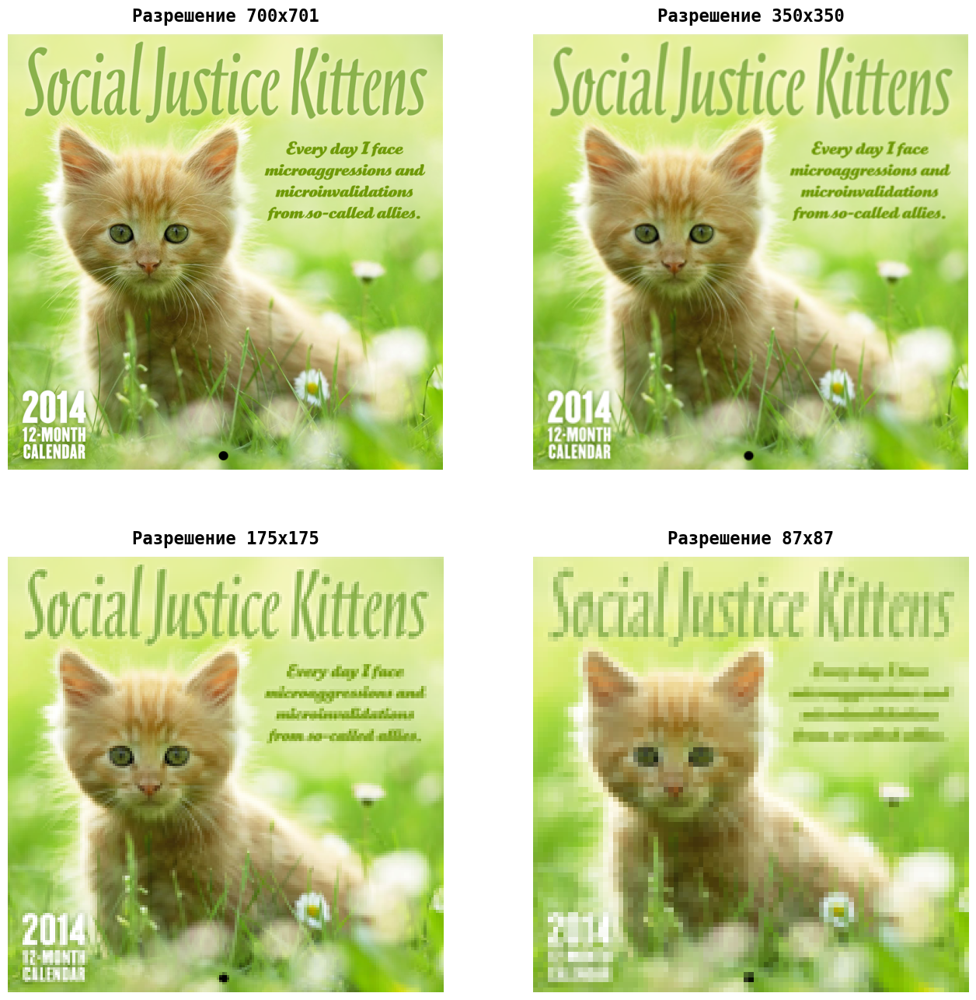

In [2]:
img = Image.open('data/test_image.png')
img_size = img.size

fig, axes = plt.subplots(2, 2, figsize=(16, 16))
denom = 1

for i in range(4):
    ax = plt.subplot(2, 2, i + 1)
    new_size = (img_size[0] // denom, img_size[1] // denom)
    ax.imshow(img.resize(new_size))
    ax.set_title(f"Разрешение {new_size[0]}x{new_size[1]}")
    ax.axis("off")
    denom *= 2

plt.show()

* Алгоритмы хранения изображений, понижающие их качество для сокращения занимаемого места в памяти (сжатие с потерями). Самый популярный формат - `.JPG`

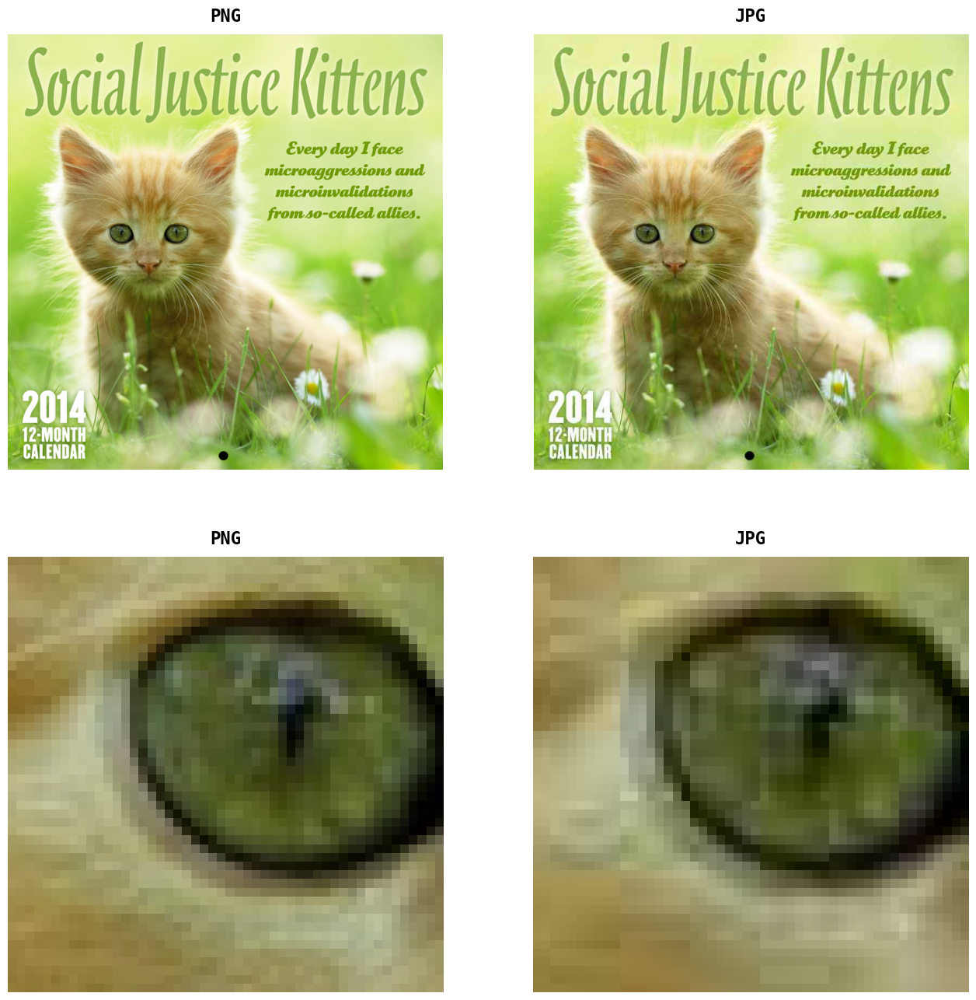

In [3]:
img.save('data/test_image.jpg', 'JPEG', quality=30)

jpg_img = Image.open('data/test_image.jpg')

fig, axes = plt.subplots(2, 2, figsize=(16, 16))

for i in range(4):
    ax = plt.subplot(2, 2, i + 1)
    current = jpg_img if i % 2 else img
    if i > 1:
        current = current.crop((150, 300, 200, 350))
    ax.imshow(current)
    ax.set_title(f"{'JPG' if i % 2 else 'PNG'}")
    ax.axis("off")

plt.show()

* Несовершенство матрицы фотокамеры, вследствие чего возникают шумы, размытия и артефакты:

In [4]:
from PIL import ImageFilter
import cv2

def noise(img, n=0.2):
    img = np.array(img)
    row, col, ch = img.shape
    noise = np.random.uniform(0, n, size=(row, col, ch))
    noise_img = np.clip(img / 255 + noise, 0, 1) * 255

    return noise_img.astype('uint8')

def motion_blur(img, size=10):
    img = np.array(img)
    kernel_motion_blur = np.zeros((size, size))
    kernel_motion_blur[int((size-1)/2), :] = np.ones(size)
    kernel_motion_blur /= size
    return cv2.filter2D(img, -1, kernel_motion_blur)

def artefacts(img, n=0.75):
    img = np.array(img)
    noise = np.random.normal(0, n, size=img.shape).astype('uint8')
    result = img + noise
    return result

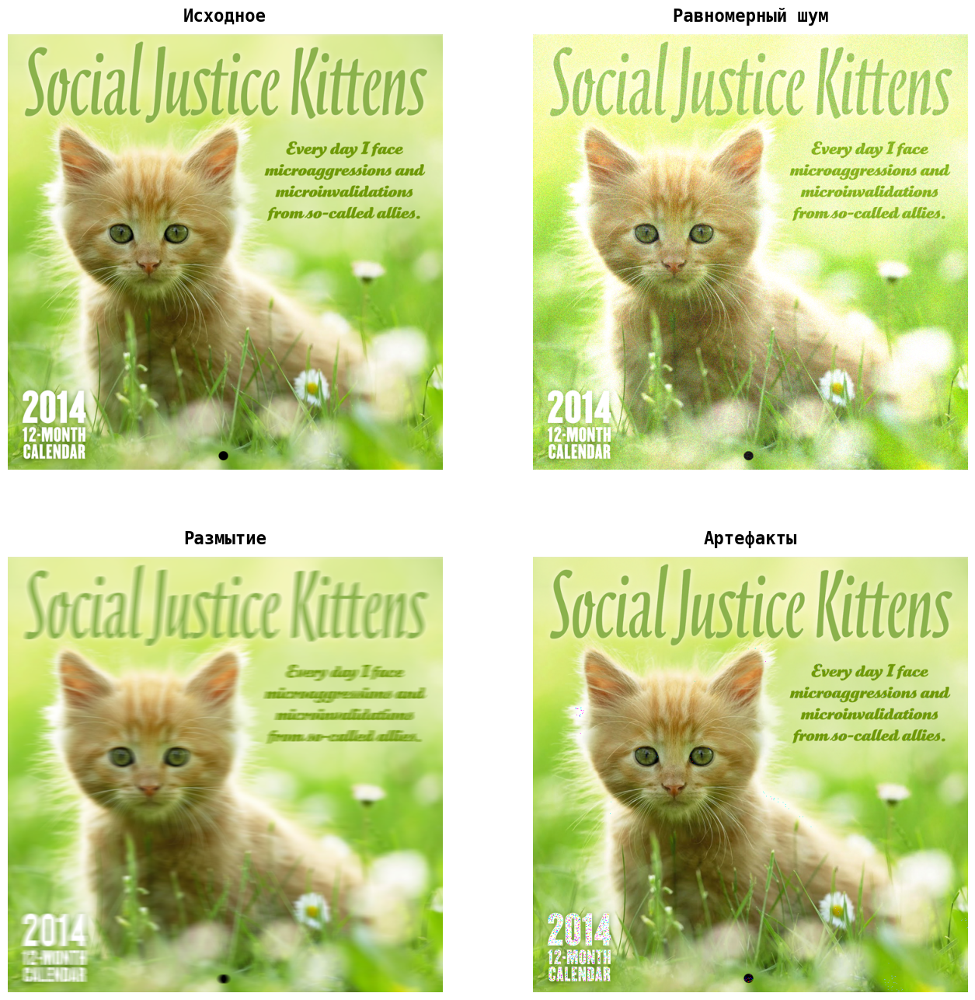

In [5]:
fig, axes = plt.subplots(2, 2, figsize=(16, 16))

titles = ['Исходное', 'Равномерный шум', 'Размытие', 'Артефакты']
funcs = [lambda x: x, lambda x: noise(x), 
         lambda x: motion_blur(x), lambda x: artefacts(x)]

for i in range(4):
    ax = plt.subplot(2, 2, i + 1)
    ax.imshow(funcs[i](img))
    ax.set_title(titles[i])
    ax.axis("off")

plt.show()

Попробуем "испортить" фотографию, применив некоторые из перечисленных методов:

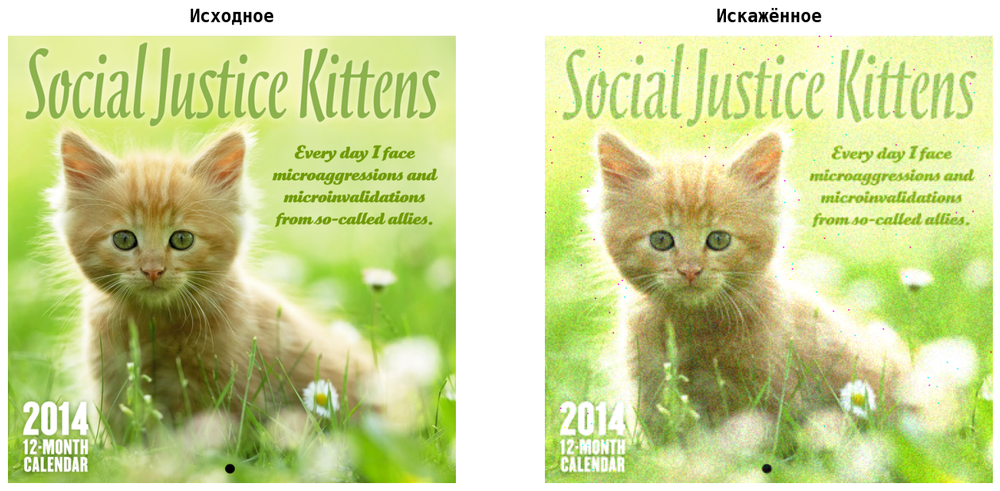

In [6]:
fig, axes = plt.subplots(1, 2, figsize=(16, 8))

axes[0].imshow(img)
axes[0].set_title("Исходное")
axes[0].axis("off")
axes[1].imshow(artefacts(noise(img.resize((350, 350))), 0.35))
axes[1].set_title("Искажённое")
axes[1].axis("off")

plt.show()

<style>
h1:after,
h2:after,
h3:after,
h4:after {
    position: absolute;
    content: "";
    left: 0;
    top: 0;
    bottom: 0;
    width: 5px;
    border-radius: 5px;
    box-shadow:
        inset 0 1px 1px rgba(0,0,0,0.5),
        0 1px 1px rgba(255,255,255,0.3);
}
 
h1:after { background: #aaf683; left: 0; padding: 0 0 0 10px;}
h2:after { background: #aaf683; left: 10px; padding: 0 0 0 5px;}
h3:after { background: #aaf683; left: 20px;}
h4:after { background: #aaf683; left: 30px;}
 
h1 {
    font-size: 36px;
    line-height: 40px;
    padding: 0 0 0 25px;
    margin: 1em 0 .6em 0;
    font-weight: normal;
    
    font-family: 'Hammersmith One', sans-serif;
    text-shadow: 1px 1px 2px rgba(0,0,0,0.4);
    position: relative;
}
 
h2 {
    margin: 1em 0 .6em 0;
    padding: 0 0 0 35px;
    font-weight: normal;
    
    font-family: 'Hammersmith One', sans-serif;
    text-shadow: 1px 1px 2px rgba(0,0,0,0.4);
    position: relative;
    font-size: 30px;
    line-height: 36px;
}
 
h3 {
    margin: 1em 0 .6em 0;
    padding: 0 0 0 40px;
    font-weight: normal;
    
    font-family: 'Hammersmith One', sans-serif;
    text-shadow: 1px 1px 2px rgba(0,0,0,0.4);
    position: relative;
    font-size: 24px;
    line-height: 32px;
    font-family: 'Questrial', sans-serif;
}
 
h4 {
    margin: 1em 0 .6em 0;
    padding: 0 0 0 50px;
    font-weight: normal;
    
    font-family: 'Hammersmith One', sans-serif;
    text-shadow: 1px 1px 2px rgba(0,0,0,0.4);
    position: relative;
    font-size: 18px;
    line-height: 28px;
    font-family: 'Questrial', sans-serif;
}
</style>

## <h2>Существующие подходы для решения задачи повышения качества изображений</h2> <a class="anchor" id="theory_methods"></a>

К сожалению, классическое машинное обучение бессильно в задачах обработки изображений на фоне глубоких нейронных сетей. К тому же, модели машинного обучения не могут выдавать набор пикселей. Поэтому для решения поставленной задачи воспользуемся <svg width=15px style="color: red" role="img" viewBox="0 0 24 24" xmlns="http://www.w3.org/2000/svg"><title>PyTorch</title><path d="M12.005 0L4.952 7.053a9.865 9.865 0 000 14.022 9.866 9.866 0 0014.022 0c3.984-3.9 3.986-10.205.085-14.023l-1.744 1.743c2.904 2.905 2.904 7.634 0 10.538s-7.634 2.904-10.538 0-2.904-7.634 0-10.538l4.647-4.646.582-.665zm3.568 3.899a1.327 1.327 0 00-1.327 1.327 1.327 1.327 0 001.327 1.328A1.327 1.327 0 0016.9 5.226 1.327 1.327 0 0015.573 3.9z" fill="red"></path></svg> <b>PyTorch</b> - фреймворком для работы с глубоким обучением.

<style>
h1:after,
h2:after,
h3:after,
h4:after {
    position: absolute;
    content: "";
    left: 0;
    top: 0;
    bottom: 0;
    width: 5px;
    border-radius: 5px;
    box-shadow:
        inset 0 1px 1px rgba(0,0,0,0.5),
        0 1px 1px rgba(255,255,255,0.3);
}
 
h1:after { background: #aaf683; left: 0; padding: 0 0 0 10px;}
h2:after { background: #aaf683; left: 10px; padding: 0 0 0 5px;}
h3:after { background: #aaf683; left: 20px;}
h4:after { background: #aaf683; left: 30px;}
 
h1 {
    font-size: 36px;
    line-height: 40px;
    padding: 0 0 0 25px;
    margin: 1em 0 .6em 0;
    font-weight: normal;
    
    font-family: 'Hammersmith One', sans-serif;
    text-shadow: 1px 1px 2px rgba(0,0,0,0.4);
    position: relative;
}
 
h2 {
    margin: 1em 0 .6em 0;
    padding: 0 0 0 35px;
    font-weight: normal;
    
    font-family: 'Hammersmith One', sans-serif;
    text-shadow: 1px 1px 2px rgba(0,0,0,0.4);
    position: relative;
    font-size: 30px;
    line-height: 36px;
}
 
h3 {
    margin: 1em 0 .6em 0;
    padding: 0 0 0 40px;
    font-weight: normal;
    
    font-family: 'Hammersmith One', sans-serif;
    text-shadow: 1px 1px 2px rgba(0,0,0,0.4);
    position: relative;
    font-size: 24px;
    line-height: 32px;
    font-family: 'Questrial', sans-serif;
}
 
h4 {
    margin: 1em 0 .6em 0;
    padding: 0 0 0 50px;
    font-weight: normal;
    
    font-family: 'Hammersmith One', sans-serif;
    text-shadow: 1px 1px 2px rgba(0,0,0,0.4);
    position: relative;
    font-size: 18px;
    line-height: 28px;
    font-family: 'Questrial', sans-serif;
}
</style>

### <h3>Свёрточные нейронные сети</h3>  <a class="anchor" id="theory_methods_cnn"></a>

Понятие <b>свёртки</b> (конволюции) появилось ещё в конце 18 века. На сегодняшний момент [свёрточные ядра](https://ru.wikipedia.org/wiki/%D0%AF%D0%B4%D1%80%D0%BE_%D1%81%D0%B2%D0%B5%D1%80%D1%82%D0%BA%D0%B8) получили широкое распространение при обработке изображений, потому что те позволяют получить множество интересных эффектов. Например, свёрточное ядро следующего вида:

$\begin{bmatrix}
-2 & -1 & 0 \\
-1 & 1 & 1 \\
0 & 1 & 2 \\
\end{bmatrix}$

Позволяет выполнить тиснение фотографии, то есть придать ей объём:

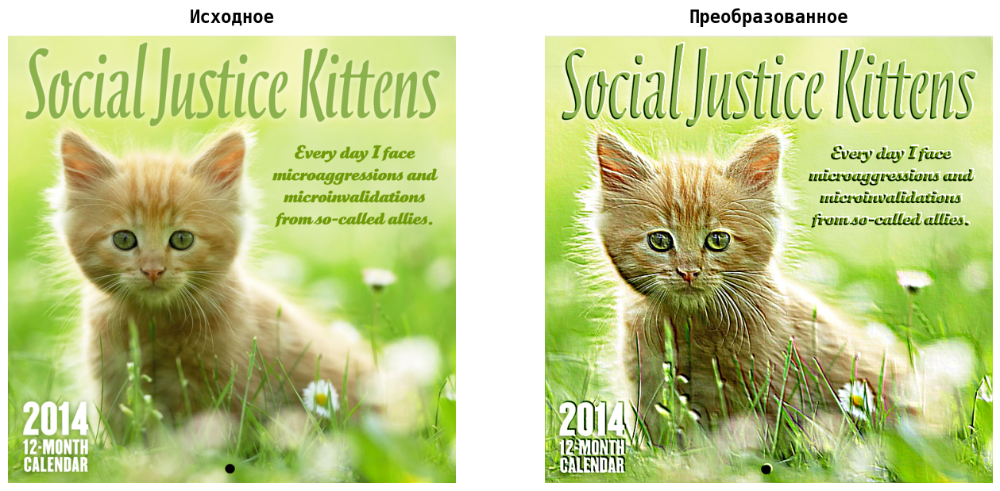

In [7]:
kernel = [-2, -1, 0,
          -1, 1, 1,
          0, 1, 2]

fig, axes = plt.subplots(1, 2, figsize=(16, 8))

axes[0].imshow(img)
axes[0].set_title("Исходное")
axes[0].axis("off")
axes[1].imshow(img.filter(ImageFilter.Kernel((3, 3), kernel)))
axes[1].set_title("Преобразованное")
axes[1].axis("off")

plt.show()

Или, например, получить размытие изображения при помощи этого ядра:

$\frac 1 9\begin{bmatrix}
1 & 1 & 1 \\
1 & 1 & 1 \\
1 & 1 & 1 \\
\end{bmatrix}$

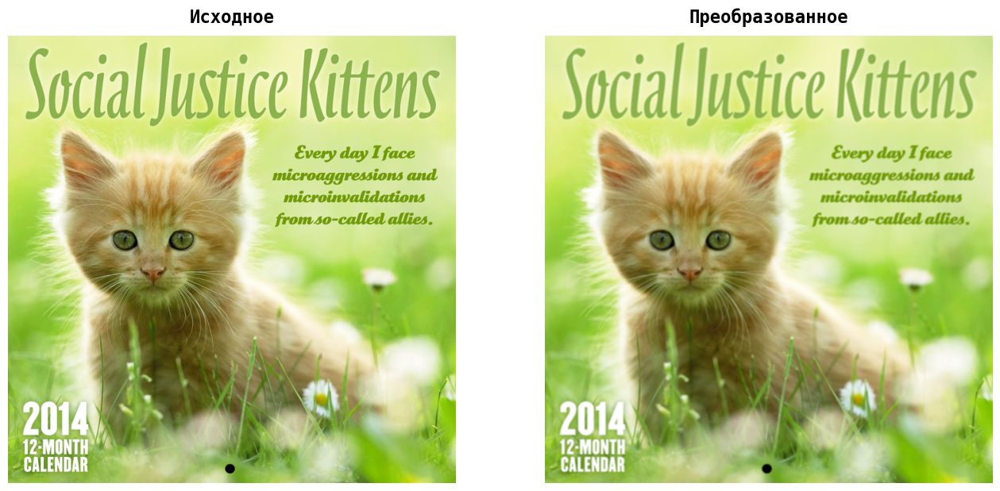

In [8]:
kernel = [1, 1, 1,
          1, 1, 1,
          1, 1, 1]

kernel = np.array(kernel) / 9

fig, axes = plt.subplots(1, 2, figsize=(16, 8))

axes[0].imshow(img)
axes[0].set_title("Исходное")
axes[0].axis("off")
axes[1].imshow(img.filter(ImageFilter.Kernel((3, 3), kernel)))
axes[1].set_title("Преобразованное")
axes[1].axis("off")

plt.show()

Работа свёртки достаточно проста для понимания: необходимо "приложить" ядро к каждому пикселю исходного изображения, умножить соответсвующие значения пикселей на коэффициенты ядра, просуммировать и получить новый пиксель преобразованного изображения. Наглядную демонстрацию работы можно увидеть на анимации:

<img src="https://i.postimg.cc/QdqzDH6B/conv-full-layer.gif">

Различные свёрточные ядра разработали люди по интуитивному понятию. Принцип работы свёрточного слоя нейронной сети такой же, за исключением того, что значения ядра изначально неизвестны - именно их нейросеть и будет "подбирать".

Заметим очень важную деталь: операция свёртки уменьшает размер исходного изображения на $n - 1$ пикселей, где $n$ - размерность свёрточного ядра. Так как же тогда свёртка может помочь улучшить качество фотографии, если она уменьшает её размер?

Во-первых, к исходному изображению можно добавить "пустые" значения с краёв таким образом, чтобы свёрточное ядро смогло пройтись по всем ячейках исходного слоя.

А во-вторых, нужно отметить, что операции свёртки обратима, то есть может работать в другую сторону. Это называется <b>транспонированной свёрткой</b> (деконволюцией).

Методы для повышения качества изображения, основанные на свёрточных слоях, образуют группу моделей <b>$\textbf{SRCNN}$</b> ($\text{Super-Resolution Convolution Neural Network}$). Приведём основные подходы:

<style>
    img {
      width: 1000px;
    }
</style>

- $\textbf{Pre-upsampling}$

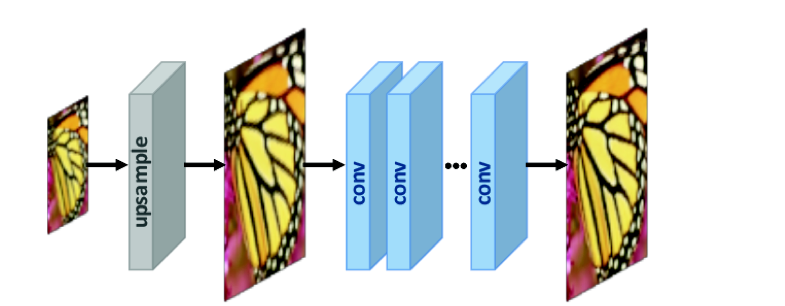

Суть подхода заключается в том, что изображение изначально растягивается в несколько раз с помощью интерполяции, а затем свёрточными слоями доводится до необходимого разрешения, сохраняя при этом размерность. Именно свёрточные ядра помогут в повышении качества, самостоятельно выделив необходимые признаки и улучшив их.

<style>
    img {
      width: 1000px;
    }
</style>

- $\textbf{Post-upsampling}$

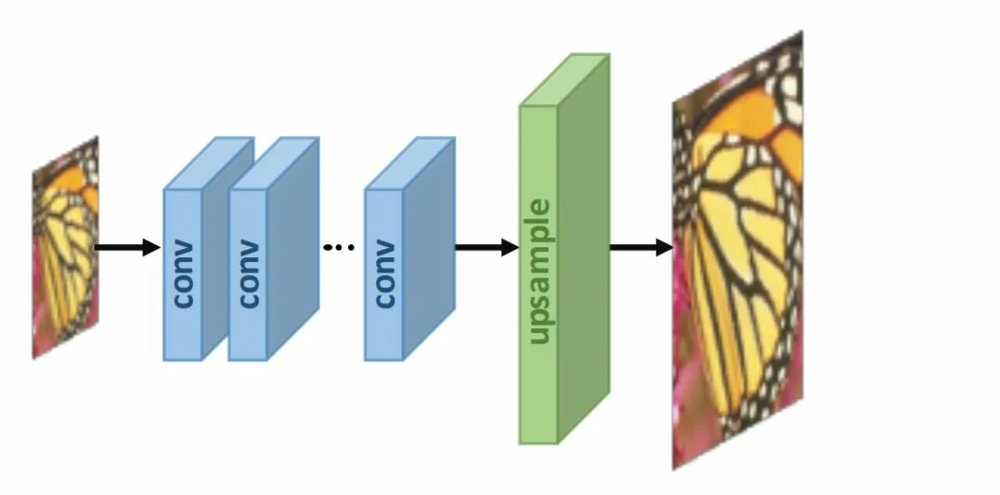

Здесь нейронная сеть сначала самостоятельно выделяет важные признаки с помощью свёрточных слоёв, а на последнем обучаемом слое использует транспонированную свёрту для повышения разрешения. Преимущество перед $\text{pre-upsampling}$ заключается в меньших потребностях вычислительной мощности, так как "свернуть" картинку меньшего размера намного проще, чем большего.

<style>
    img {
      width: 1000px;
    }
</style>

- $\textbf{Progressive upsampling}$

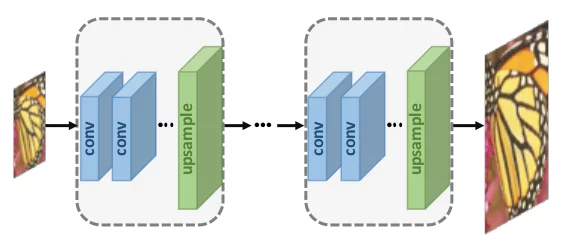

Недостатком $\text{Post-upsampling}$ было то, что слой транспонированной свёртки был лишь один, что усложняет процесс обучения. Если разложить этот слой на несколько этапов, лишь постепенно увеличивая размерность, можно добиться лучшего эффекта. В данном методе по сути реализован множественный $\text{Post-upsampling}$. Однако метод хорошо работает лишь для кратных увеличений.

<style>
h1:after,
h2:after,
h3:after,
h4:after {
    position: absolute;
    content: "";
    left: 0;
    top: 0;
    bottom: 0;
    width: 5px;
    border-radius: 5px;
    box-shadow:
        inset 0 1px 1px rgba(0,0,0,0.5),
        0 1px 1px rgba(255,255,255,0.3);
}
 
h1:after { background: #aaf683; left: 0; padding: 0 0 0 10px;}
h2:after { background: #aaf683; left: 10px; padding: 0 0 0 5px;}
h3:after { background: #aaf683; left: 20px;}
h4:after { background: #aaf683; left: 30px;}
 
h1 {
    font-size: 36px;
    line-height: 40px;
    padding: 0 0 0 25px;
    margin: 1em 0 .6em 0;
    font-weight: normal;
    
    font-family: 'Hammersmith One', sans-serif;
    text-shadow: 1px 1px 2px rgba(0,0,0,0.4);
    position: relative;
}
 
h2 {
    margin: 1em 0 .6em 0;
    padding: 0 0 0 35px;
    font-weight: normal;
    
    font-family: 'Hammersmith One', sans-serif;
    text-shadow: 1px 1px 2px rgba(0,0,0,0.4);
    position: relative;
    font-size: 30px;
    line-height: 36px;
}
 
h3 {
    margin: 1em 0 .6em 0;
    padding: 0 0 0 40px;
    font-weight: normal;
    
    font-family: 'Hammersmith One', sans-serif;
    text-shadow: 1px 1px 2px rgba(0,0,0,0.4);
    position: relative;
    font-size: 24px;
    line-height: 32px;
    font-family: 'Questrial', sans-serif;
}
 
h4 {
    margin: 1em 0 .6em 0;
    padding: 0 0 0 50px;
    font-weight: normal;
    
    font-family: 'Hammersmith One', sans-serif;
    text-shadow: 1px 1px 2px rgba(0,0,0,0.4);
    position: relative;
    font-size: 18px;
    line-height: 28px;
    font-family: 'Questrial', sans-serif;
}
</style>

### <h3>Генеративные модели</h3> <a class="anchor" id="theory_methods_gan"></a>

<style>
    img {
      width: 1000px;
    }
</style>

Рассмотрим также генеративно-состязательные модель $\text{GAN}$, в нашем случае $\textbf{SR-GAN}$ ($\text{Super-Resolution Generative Adversarial Network}$). Их архитектура состоит из генератора и дискриминатора, настроенные работать друг против друга. В этой сети генератор создаёт на основе данных "ложные", и подаёт вместе с реальными данными дискриминатору, задача которого в свою очередь определить "реальность" данных.

Обычный пример для описания работы модели - фальсификатор (генератор) и полицейский (дискриминатор), где фальсификатор учится всё лучше и лучше подделывать купюры, а полицейский учится разделять ложные и нормальные деньги.

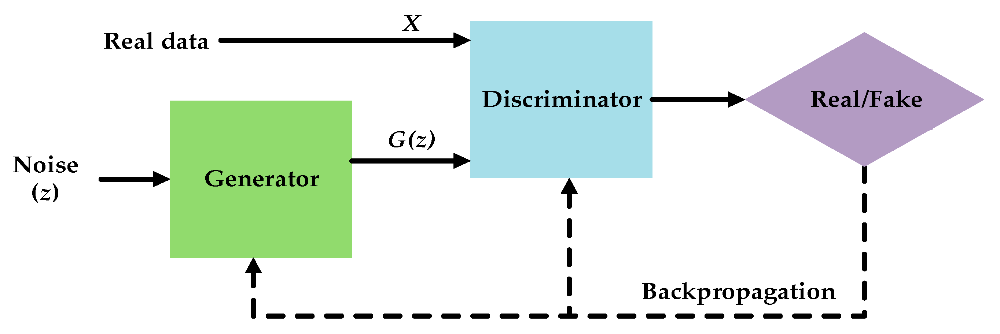

<style>
h1:after,
h2:after,
h3:after,
h4:after {
    position: absolute;
    content: "";
    left: 0;
    top: 0;
    bottom: 0;
    width: 5px;
    border-radius: 5px;
    box-shadow:
        inset 0 1px 1px rgba(0,0,0,0.5),
        0 1px 1px rgba(255,255,255,0.3);
}
 
h1:after { background: #aaf683; left: 0; padding: 0 0 0 10px;}
h2:after { background: #aaf683; left: 10px; padding: 0 0 0 5px;}
h3:after { background: #aaf683; left: 20px;}
h4:after { background: #aaf683; left: 30px;}
 
h1 {
    font-size: 36px;
    line-height: 40px;
    padding: 0 0 0 25px;
    margin: 1em 0 .6em 0;
    font-weight: normal;
    
    font-family: 'Hammersmith One', sans-serif;
    text-shadow: 1px 1px 2px rgba(0,0,0,0.4);
    position: relative;
}
 
h2 {
    margin: 1em 0 .6em 0;
    padding: 0 0 0 35px;
    font-weight: normal;
    
    font-family: 'Hammersmith One', sans-serif;
    text-shadow: 1px 1px 2px rgba(0,0,0,0.4);
    position: relative;
    font-size: 30px;
    line-height: 36px;
}
 
h3 {
    margin: 1em 0 .6em 0;
    padding: 0 0 0 40px;
    font-weight: normal;
    
    font-family: 'Hammersmith One', sans-serif;
    text-shadow: 1px 1px 2px rgba(0,0,0,0.4);
    position: relative;
    font-size: 24px;
    line-height: 32px;
    font-family: 'Questrial', sans-serif;
}
 
h4 {
    margin: 1em 0 .6em 0;
    padding: 0 0 0 50px;
    font-weight: normal;
    
    font-family: 'Hammersmith One', sans-serif;
    text-shadow: 1px 1px 2px rgba(0,0,0,0.4);
    position: relative;
    font-size: 18px;
    line-height: 28px;
    font-family: 'Questrial', sans-serif;
}
</style>

## <h2>Методы оценки схожести изображений</h2> <a class="anchor" id="theory_similarity"></a>

Для применения метода обратного распространения ошибки (или любого другого подхода обучения с учителем) нам необходимо выбрать функцию потерь. Поэтому логичен вопрос - как сравнивать два изображения между собой?

На самом деле, оценить "разницу" между изображениями проще, чем кажется. Так как цветная картинка - лишь набор из трёх матриц (каждая отвечает за свой канал - красный, синий и зелёный), то для их сравнения достаточно использовать квадратичную функцию ошибки `MSE`. В сфере обработки изображений это можно найти как `Pixel Loss`, пиксельная ошибка, что может включать в себя функции потерь `L1` (`MAE`), `L2` (`MSE`) или их комбинации.

Говоря про метрики, стоит упомянуть `PSNR` ($\text{Peak Signal-to-Noise Signal}$), тесно связанную с пиксельной ошибкой (так как она эта функция потерь и оптимизирует `PSNR`). Эта метрика определяется как:

$\text{PSNR} = 10\log{\left(\frac{\text{MAX}_I^2}{\text{MSE}}\right)}$,

где $\text{MSE}$ - квадратичная функция ошибка, а $\text{MAX}_I$ - максимальное возможное значение пикселя (например, при $8$-разрядных пикселях максимальное значение - $255$)

In [9]:
def psnr(label, outputs, max_val=1):
    diff = outputs - label
    rmse = np.sqrt(np.mean((diff) ** 2))
    if rmse == 0:
        return 100 # абсолютно индентичны
    else:
        PSNR = 20 * np.log10(max_val / rmse)
        return PSNR

Покажем, как меняется `PSNR` при уменьшении разрешения фотографии:

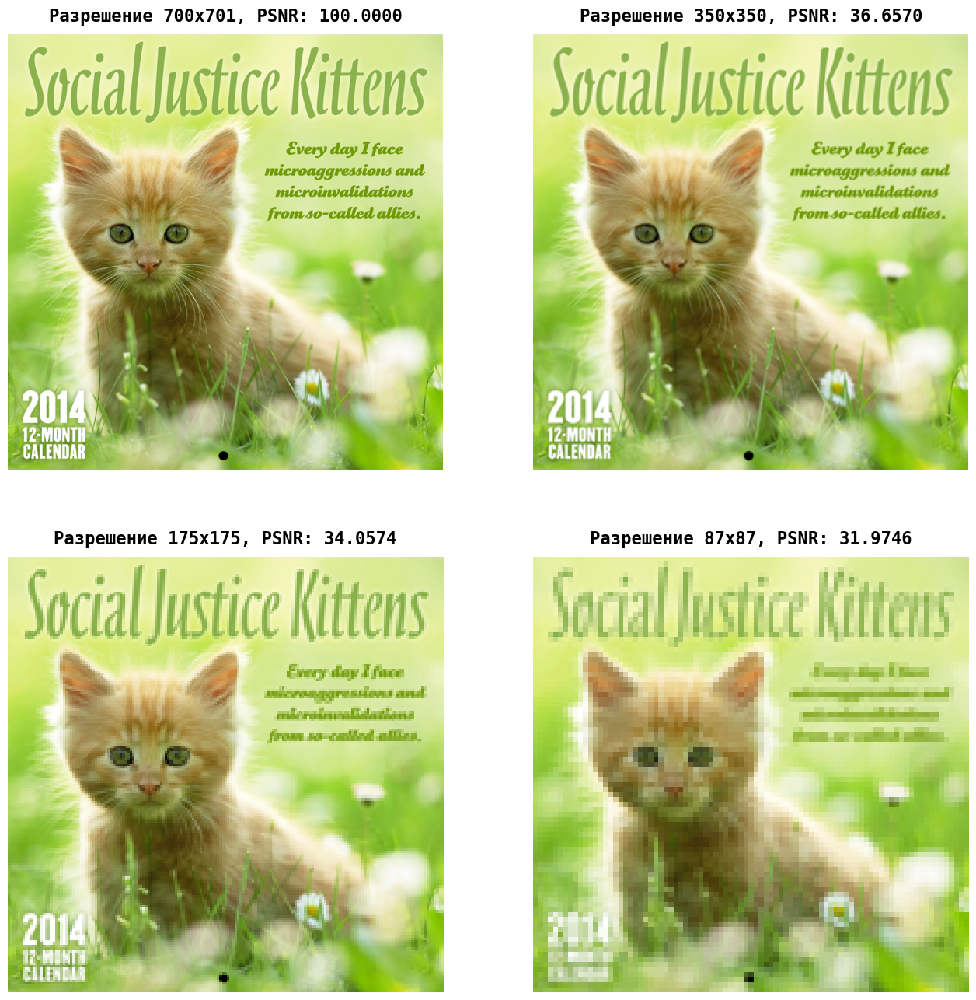

In [10]:
fig, axes = plt.subplots(2, 2, figsize=(16, 16))
denom = 1

img_size = img.size

for i in range(4):
    ax = plt.subplot(2, 2, i + 1)
    new_size = (img_size[0] // denom, img_size[1] // denom)
    ax.imshow(img.resize(new_size))
    value = psnr(np.array(img), 
                 np.array(img.resize(new_size).resize(img_size)), 255)
    ax.set_title(f"Разрешение {new_size[0]}x{new_size[1]}, PSNR: {value:.4f}")
    ax.axis("off")
    denom *= 2

plt.show()

Необходимо учесть, что `PSNR` не имеет максимума и устремляется к бесконечности при $\text{MSE} \rightarrow 0$. В случае $\text{MSE} = 0$ функция поставит значение $\text{PSNR} = 100$.

<style>
h1:after,
h2:after,
h3:after,
h4:after {
    position: absolute;
    content: "";
    left: 0;
    top: 0;
    bottom: 0;
    width: 5px;
    border-radius: 5px;
    box-shadow:
        inset 0 1px 1px rgba(0,0,0,0.5),
        0 1px 1px rgba(255,255,255,0.3);
}
 
h1:after { background: #aaf683; left: 0; padding: 0 0 0 10px;}
h2:after { background: #aaf683; left: 10px; padding: 0 0 0 5px;}
h3:after { background: #aaf683; left: 20px;}
h4:after { background: #aaf683; left: 30px;}
 
h1 {
    font-size: 36px;
    line-height: 40px;
    padding: 0 0 0 25px;
    margin: 1em 0 .6em 0;
    font-weight: normal;
    
    font-family: 'Hammersmith One', sans-serif;
    text-shadow: 1px 1px 2px rgba(0,0,0,0.4);
    position: relative;
}
 
h2 {
    margin: 1em 0 .6em 0;
    padding: 0 0 0 35px;
    font-weight: normal;
    
    font-family: 'Hammersmith One', sans-serif;
    text-shadow: 1px 1px 2px rgba(0,0,0,0.4);
    position: relative;
    font-size: 30px;
    line-height: 36px;
}
 
h3 {
    margin: 1em 0 .6em 0;
    padding: 0 0 0 40px;
    font-weight: normal;
    
    font-family: 'Hammersmith One', sans-serif;
    text-shadow: 1px 1px 2px rgba(0,0,0,0.4);
    position: relative;
    font-size: 24px;
    line-height: 32px;
    font-family: 'Questrial', sans-serif;
}
 
h4 {
    margin: 1em 0 .6em 0;
    padding: 0 0 0 50px;
    font-weight: normal;
    
    font-family: 'Hammersmith One', sans-serif;
    text-shadow: 1px 1px 2px rgba(0,0,0,0.4);
    position: relative;
    font-size: 18px;
    line-height: 28px;
    font-family: 'Questrial', sans-serif;
}
</style>

# <h1>Практическая часть</h1> <a class="anchor" id="main"></a>

In [11]:
import os
import cv2
import pandas as pd

from torch.utils.data import DataLoader
from torch.utils.data import Dataset
from torchvision.transforms import ToTensor

from torch.utils.data import random_split
import torch

import torch.nn as nn
import torch.nn.functional as F

<style>
h1:after,
h2:after,
h3:after,
h4:after {
    position: absolute;
    content: "";
    left: 0;
    top: 0;
    bottom: 0;
    width: 5px;
    border-radius: 5px;
    box-shadow:
        inset 0 1px 1px rgba(0,0,0,0.5),
        0 1px 1px rgba(255,255,255,0.3);
}
 
h1:after { background: #aaf683; left: 0; padding: 0 0 0 10px;}
h2:after { background: #aaf683; left: 10px; padding: 0 0 0 5px;}
h3:after { background: #aaf683; left: 20px;}
h4:after { background: #aaf683; left: 30px;}
 
h1 {
    font-size: 36px;
    line-height: 40px;
    padding: 0 0 0 25px;
    margin: 1em 0 .6em 0;
    font-weight: normal;
    
    font-family: 'Hammersmith One', sans-serif;
    text-shadow: 1px 1px 2px rgba(0,0,0,0.4);
    position: relative;
}
 
h2 {
    margin: 1em 0 .6em 0;
    padding: 0 0 0 35px;
    font-weight: normal;
    
    font-family: 'Hammersmith One', sans-serif;
    text-shadow: 1px 1px 2px rgba(0,0,0,0.4);
    position: relative;
    font-size: 30px;
    line-height: 36px;
}
 
h3 {
    margin: 1em 0 .6em 0;
    padding: 0 0 0 40px;
    font-weight: normal;
    
    font-family: 'Hammersmith One', sans-serif;
    text-shadow: 1px 1px 2px rgba(0,0,0,0.4);
    position: relative;
    font-size: 24px;
    line-height: 32px;
    font-family: 'Questrial', sans-serif;
}
 
h4 {
    margin: 1em 0 .6em 0;
    padding: 0 0 0 50px;
    font-weight: normal;
    
    font-family: 'Hammersmith One', sans-serif;
    text-shadow: 1px 1px 2px rgba(0,0,0,0.4);
    position: relative;
    font-size: 18px;
    line-height: 28px;
    font-family: 'Questrial', sans-serif;
}
</style>

## <h2>Сбор и предобработка данных</h2> <a class="anchor" id="main_dataset"></a>

Для получения качественной модели для нашей задачи недостаточно взять изображения из одной сферы (например, только люди или машины). Из этого можно сделать вывод о необходимости сбора разнообразных картинок. 

Для этого, конечно, можно воспользоваться поиском изображений на разные тематики в поисковых системах. Воспользовавшись парсингом, мы сможем получить любой желаемый объём изображений (в пределах здравого смысла). Однако у такого подхода есть свои недостатки: во-первых, это займёт некоторое время, а во-вторых, нет никакой гарантии, что наш датасет будет собран качественно, то есть без бесполезных и ухудшающих выборку изображений.

Есть другой подход, который исключает эти два недостатка - воспользоваться готовыми наборами изображений. Для самостоятельного выбора методов понижения качества можно выбрать датасет для классификации изображений - как правило, классы в них уже сбалансированны. Для этого отлично подошёл бы набор [ImageNet-1k](https://image-net.org/download.php), содержащий $1000$ классов и более миллиона изображений. Но для наших целей такой размер (более $160$гб) излишен, поэтому воспользуемся готовым датасетом для повышения качества изображения, например - [Image Super Resolution](https://www.kaggle.com/datasets/adityachandrasekhar/image-super-resolution).

Для дальнейшей работы потребуется создать свой собственный класс для обработки датасета. Будем использовать библиотеку `cv2`, так как она значительно быстрее, чем `Pillow`.

In [12]:
class CustomDataset(Dataset):
    def __init__(self, path, img_size=256, downscale=2, part_size=256, divide=False, transform=False):
        self.img_size = img_size
        self.downscale = downscale
        self.path = path
        self.part_size = part_size
        self.divide = divide
        self.transform = transform

        self.files = sorted(os.listdir(path))

        self.funcs = {'noise': lambda x: self.noise(x, np.random.random() * 1 / 10),
                      'motion_blur': lambda x: self.motion_blur(x, np.random.randint(1, 5)), 
                      'artefacts': lambda x: self.artefacts(x, np.random.random() / 2)}
        
        self.high = []

        for file in self.files:
            img = os.path.join(path, file)
            img = cv2.imread(img)
            img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
            for r in range(0, img.shape[0], self.part_size):
                for c in range(0, img.shape[1], self.part_size):
                    if divide:
                        for i in range(3):
                            temp = img[r:r+self.part_size, c:c+self.part_size, i].astype(np.float32) / 255
                            self.high.append(temp)
                    else:
                        temp = img[r:r+self.part_size, c:c+self.part_size, :].astype(np.float32) / 255
                        self.high.append(temp)
        
        self.high = np.array(self.high)

        if divide:
            self.high = self.high[:, :, :, np.newaxis]
                
        
    def __len__(self):
        return len(self.high)
    
    def __getitem__(self, index):
        img = self.high[index]
        low_img = self.high[index]

        if self.transform:
            low_img = self.transform_image(low_img)
        low_img = cv2.resize(low_img, (self.part_size // self.downscale, self.part_size // self.downscale))


        return {
            'high_img': ToTensor()(img),
            'low_img': ToTensor()(low_img)
        }
    
    def transform_image(self, img):
        for method in np.random.choice(list(self.funcs.values()), size=3, replace=False):
            img = method(img)

        return img
    
    def noise(self, img, n=0.2):
        img = np.array(img)
        noise = np.random.uniform(0, n, size=img.shape)
        noise_img = np.clip(img + noise, 0, 1)

        return noise_img.astype(np.float32)

    def motion_blur(self, img, size=10):
        img = np.array(img)
        kernel_motion_blur = np.zeros((size, size))
        kernel_motion_blur[int((size-1)/2), :] = np.ones(size)
        kernel_motion_blur /= size
        result = np.clip(cv2.filter2D(img, -1, kernel_motion_blur), 0, 1)
        return result.astype(np.float32)

    def artefacts(self, img, n=0.75):
        img = (np.array(img) * 255).astype(np.uint8)
        noise = np.random.normal(0, n, size=img.shape).astype('uint8')
        result = img + noise
        return np.clip(result.astype(np.float32) / 255, 0, 1)

In [13]:
dataset = CustomDataset('dataset/Raw Data/high_res')

Выведем некоторые изображения датасета попарно: высокого и низкого разрешений.

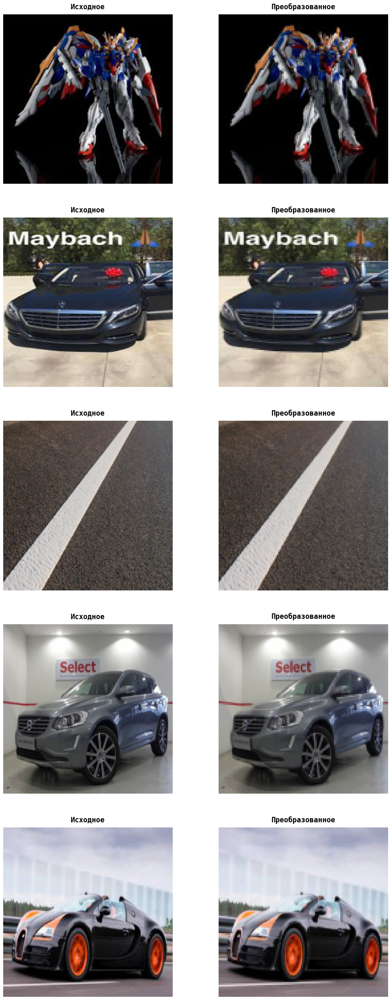

In [14]:
fig, axes = plt.subplots(5, 2, figsize=(16, 40))

for i, index in enumerate(np.random.choice(list(range(len(dataset))), size=5, replace=False)):
    data = dataset[index]
    ax = plt.subplot(5, 2, 2 * i + 1)
    ax.imshow(data['high_img'].permute(1, 2, 0))
    ax.set_title('Исходное')
    ax.axis("off")

    ax = plt.subplot(5, 2, 2 * i + 2)
    ax.imshow(data['low_img'].permute(1, 2, 0))
    ax.set_title('Преобразованное')
    ax.axis("off")

plt.show()

Разделим на тестовую, валидационную и обучающую выборки:

In [15]:
train_size = int(0.7 * len(dataset)) 
val_size = int(0.2 * len(dataset))
test_size = len(dataset) - train_size - val_size

torch.manual_seed(42)

train_set, val_set, test_set = random_split(dataset, 
                                            [train_size, val_size, test_size])

Полученные размеры выборок:

In [16]:
print(f'Обучающая: {len(train_set)}')
print(f'Валидационная: {len(val_set)}')
print(f'Тестовая: {len(test_set)}')

Обучающая: 598
Валидационная: 171
Тестовая: 86


И, наконец, создадим загрузчики, которые будут непосредственно подавать изображения в нейросеть:

In [17]:
batch_size = 8
train_loader = DataLoader(train_set, batch_size=batch_size, shuffle=True)
val_loader = DataLoader(val_set, batch_size=batch_size, shuffle=False)
test_loader = DataLoader(test_set, batch_size=batch_size, shuffle=False)

Объявим также функцию для подсчёта метрики `PSNR`, адаптированную к работе с фреймворком:

In [18]:
def psnr(label, outputs, max_val=1.):
    if isinstance(label, torch.Tensor):
        label = label.cpu().detach().numpy()
    if isinstance(outputs, torch.Tensor):
        outputs = outputs.cpu().detach().numpy()
    diff = outputs - label
    rmse = np.sqrt(np.mean((diff) ** 2))
    if rmse == 0:
        return 100 # абсолютно индентичны
    else:
        PSNR = 20 * np.log10(max_val / rmse)
        return PSNR

Так как `PSNR` не имеет максимального значения, то расчитаем её на примере билинейной интерполяции, чтобы была возможность сравнить результаты:

In [19]:
psnr_stat = 0

for data in dataset:
    high_img = data['high_img'].cpu().detach().permute(1, 2, 0).numpy()
    low_img = data['low_img'].cpu().detach().permute(1, 2, 0).numpy()
    low_img = cv2.resize(low_img, (low_img.shape[1] * 2, low_img.shape[0] * 2))
    psnr_stat += psnr(high_img, low_img)

In [20]:
psnr_stat / (len(dataset))

29.27944249876982

Фактически это число означает, что если модель в среднем выдаёт `PSNR` больше него, то модель улучшает изображение лучше, чем билинейная интерполяция.

<style>
h1:after,
h2:after,
h3:after,
h4:after {
    position: absolute;
    content: "";
    left: 0;
    top: 0;
    bottom: 0;
    width: 5px;
    border-radius: 5px;
    box-shadow:
        inset 0 1px 1px rgba(0,0,0,0.5),
        0 1px 1px rgba(255,255,255,0.3);
}
 
h1:after { background: #aaf683; left: 0; padding: 0 0 0 10px;}
h2:after { background: #aaf683; left: 10px; padding: 0 0 0 5px;}
h3:after { background: #aaf683; left: 20px;}
h4:after { background: #aaf683; left: 30px;}
 
h1 {
    font-size: 36px;
    line-height: 40px;
    padding: 0 0 0 25px;
    margin: 1em 0 .6em 0;
    font-weight: normal;
    
    font-family: 'Hammersmith One', sans-serif;
    text-shadow: 1px 1px 2px rgba(0,0,0,0.4);
    position: relative;
}
 
h2 {
    margin: 1em 0 .6em 0;
    padding: 0 0 0 35px;
    font-weight: normal;
    
    font-family: 'Hammersmith One', sans-serif;
    text-shadow: 1px 1px 2px rgba(0,0,0,0.4);
    position: relative;
    font-size: 30px;
    line-height: 36px;
}
 
h3 {
    margin: 1em 0 .6em 0;
    padding: 0 0 0 40px;
    font-weight: normal;
    
    font-family: 'Hammersmith One', sans-serif;
    text-shadow: 1px 1px 2px rgba(0,0,0,0.4);
    position: relative;
    font-size: 24px;
    line-height: 32px;
    font-family: 'Questrial', sans-serif;
}
 
h4 {
    margin: 1em 0 .6em 0;
    padding: 0 0 0 50px;
    font-weight: normal;
    
    font-family: 'Hammersmith One', sans-serif;
    text-shadow: 1px 1px 2px rgba(0,0,0,0.4);
    position: relative;
    font-size: 18px;
    line-height: 28px;
    font-family: 'Questrial', sans-serif;
}
</style>

## <h2>Обучение моделей</h2> <a class="anchor" id="main_train"></a>

Для сравнения различных видов моделей будем придерживаться следующих правил:

- Цель: повысить качество изображение путём увеличения разрешения в $2$ раза
- Количество эпох: $100$
- Сравнение с билинейной интерполяцией 

Будем использовать следующие архитектуры для реализации моделей:

- $\text{Pre-upsampling}$: `SRCNN` - увеличение разрешения билинейной интерполяцией, три свёрточных слоя с ядрами $5\text{x}5$, $1\text{x}1$, $9\text{x}9$.
- $\text{Post-upsampling}$: `FSRCNN` - $m=4$ свёрточных слоя с параметрами $d=56$ (слои с выделением признаков), $s=16$ (свёрточные слои) и слой транспонированной свёртки в качестве последнего $\text{upsampling}$ слоя.
- $\text{GAN}$: `SRGAN` - несколько предобученная модель (30 эпох) с дообучением.

In [21]:
device = 'cuda' if torch.cuda.is_available() else 'cpu'

device

'cuda'

Определим собственные классы `Results` и `Trainer` для упрощения работы с результатами и обучением модели соответственно.

In [22]:
class Results():
    def __init__(self, path):
        self.train_loss = []
        self.train_psnr = []
        self.val_loss = []
        self.val_psnr = []
        self.time = []
        self.path = path

    def update(self, train_loss, train_psnr, val_loss, val_psnr, time):
        self.train_loss.append(train_loss)
        self.train_psnr.append(train_psnr)
        self.val_loss.append(val_loss)
        self.val_psnr.append(val_psnr)
        self.time.append(time)

        self.save()

    def __getitem__(self, index):
        return self.train_loss[index], self.train_psnr[index], self.val_loss[index], self.val_psnr[index], self.time[index]
    
    def plot(self):
        fig, axes = plt.subplots(1, 2, figsize=(12, 6))

        axes[0].plot(self.train_loss, color='orange', label='Train loss')
        axes[0].plot(self.val_loss, color='red', label='Validataion loss')
        axes[0].set_xlabel('Эпоха')
        axes[0].set_ylabel('Loss')
        axes[0].set_title('Величина ошибки')
        axes[0].grid(alpha=0.5, linestyle=':')
        axes[0].legend()

        axes[1].plot(self.train_psnr, color='green', label='Train PSNR')
        axes[1].plot(self.val_psnr, color='blue', label='Validataion PSNR')
        axes[1].set_xlabel('Эпоха')
        axes[1].set_ylabel('PSNR')
        axes[1].set_title('Значение метрики')
        axes[1].grid(alpha=0.5, linestyle=':')
        axes[1].legend()

        plt.show()

    def summary(self):
        data = pd.DataFrame([self.val_loss, self.val_psnr]).T

        data.columns = ['Validation loss', 'Validation PSNR']

        data = data.groupby(data.index // 10).last()

        data.index = (data.index + 1) * 10

        data.index.name = 'Epoch'

        print(f'Среднее время за эпоху: {np.mean(self.time)}')

        display(data.style
                .highlight_min('Validation loss', axis=0, color='lightgreen')
                .highlight_max('Validation PSNR', axis=0, color='lightgreen'))

    def save(self):
        np.save(self.path, np.array([self.train_loss, self.val_loss, self.train_psnr, self.val_psnr, self.time]))

    @staticmethod
    def load(path):
        arr = np.load(path, allow_pickle=True)
        result = Results(path)
        result.train_loss = arr[0, :]
        result.val_loss = arr[1, :]
        result.train_psnr = arr[2, :]
        result.val_psnr = arr[3, :]
        result.time = arr[4, :]

        return result

In [23]:
class Trainer_SRCNN():
    def __init__(self, model, train_loader, val_loader, optimizer, criterion,
                 output_path='.', is_divided=False, path_result=None):
        self.model = model
        self.train_loader = train_loader
        self.val_loader = val_loader
        self.optimizer = optimizer
        self.criterion = criterion

        self.output_path = output_path

        self.is_divided = is_divided

        if path_result is None:
            path_result = os.path.join(self.output_path, 'results.npy')
            self.results = Results(path_result)
        else:
            self.results = Results.load(path_result)

    def train_model(self):
        self.model.train()

        running_loss = 0
        running_psnr = 0

        for data in self.train_loader:
            image_data = data['low_img'].to(device)
            label = data['high_img'].to(device)
            
            self.optimizer.zero_grad()

            outputs = self.model(image_data)
            loss = self.criterion(outputs, label)

            loss.backward()
            self.optimizer.step()

            running_loss += loss.item()
            running_psnr += self.psnr(label, outputs)
        
        final_loss = running_loss/len(self.train_loader.dataset) * self.train_loader.batch_size
        final_psnr = running_psnr/len(self.train_loader.dataset) * self.train_loader.batch_size

        return final_loss, final_psnr
    
    def validate_model(self, loader=None):
        self.model.eval()
        
        if loader is None:
            loader = self.val_loader

        running_loss = 0
        running_psnr = 0

        with torch.no_grad():
            for data in loader:
                image_data = data['low_img'].to(device)
                label = data['high_img'].to(device)
                
                outputs = self.model(image_data)
                loss = self.criterion(outputs, label)

                running_loss += loss.item()
                running_psnr += self.psnr(label, outputs)

        final_loss = running_loss/len(loader.dataset) * loader.batch_size
        final_psnr = running_psnr/len(loader.dataset) * loader.batch_size

        return final_loss, final_psnr
    
    def train(self, num_epochs=100, save_every=10):
        for epoch in (bar := tqdm(range(num_epochs))):
            time_last = dt.datetime.now()
            train_epoch_loss, train_epoch_psnr = self.train_model()
            val_epoch_loss, val_epoch_psnr = self.validate_model()
            self.results.update(train_epoch_loss, train_epoch_psnr, val_epoch_loss, val_epoch_psnr, dt.datetime.now() - time_last)
            if (epoch + 1) % save_every == 0:
                self.save_model(epoch + 1)
            bar.set_description(f"LOSS {train_epoch_loss:.4f}/{val_epoch_loss:.4f} PSNR {train_epoch_psnr:.4f}/{val_epoch_psnr:.4f}")

    def psnr(self, label, outputs, max_val=1.):
        if isinstance(label, torch.Tensor):
            label = label.cpu().detach().numpy()
        if isinstance(outputs, torch.Tensor):
            outputs = outputs.cpu().detach().numpy()
        diff = outputs - label
        rmse = np.sqrt(np.mean((diff) ** 2))
        if rmse == 0:
            return 100 # абсолютно индентичны
        else:
            PSNR = 20 * np.log10(max_val / rmse)
            return PSNR
    
    def save_model(self, epoch):
        torch.save(self.model.state_dict(), os.path.join(self.output_path, f'model_{epoch}.pth'))

    def show_predict(self, path):
        fig, axes = plt.subplots(2, 2, figsize=(20, 20))

        self.model.eval()

        high_img = cv2.imread(path).astype(np.float32) / 255
        high_img = cv2.cvtColor(high_img, cv2.COLOR_BGR2RGB)
        low_img = cv2.resize(high_img, (high_img.shape[0] // 2, high_img.shape[1] // 2))

        high_img = torch.Tensor(high_img).to(device).permute(2, 0, 1)
        low_img = torch.Tensor(low_img).to(device).permute(2, 0, 1)
        
        if not self.is_divided:
            outputs = self.model(low_img[None, :, :, :])
        else:
            out = []
            for j in range(3):
                img = low_img[j][None, :, :]
                img = img.unsqueeze(0)
                outputs = self.model(img)
                outputs = outputs.cpu().detach()
                out.append(outputs.squeeze().numpy())
            outputs = torch.Tensor(np.array(out))

        outputs_psnr = self.psnr(high_img, outputs)
        bilinear_psnr = self.psnr(cv2.resize(low_img.permute(1, 2, 0).cpu().detach().numpy(), (256, 256)), high_img.squeeze().permute(1, 2, 0))

        axes[0, 0].imshow(low_img.cpu().permute(1, 2, 0))
        axes[0, 0].set_title('Низкое разрешение')
        axes[0, 0].axis('off')

        axes[1, 0].imshow(cv2.resize(low_img.cpu().permute(1, 2, 0).detach().numpy(), (256, 256)))
        axes[1, 0].set_title(f'Билинейная интерполяция, PSNR: {bilinear_psnr:.4f}')
        axes[1, 0].axis('off')

        axes[1, 1].imshow(np.clip(outputs.squeeze().cpu().detach().permute(1, 2, 0), 0, 1))
        axes[1, 1].set_title(f'Предсказанное изображение, PSNR: {outputs_psnr:.4f}')
        axes[1, 1].axis('off')

        axes[0, 1].imshow(high_img.cpu().permute(1, 2, 0))
        axes[0, 1].set_title('Высокое разрешение')
        axes[0, 1].axis('off')

        plt.show()

    @staticmethod
    def load_model(path, model, train_loader, val_loader, optimizer, criterion,
                   output_path='.', is_divided=False, path_result=None):
        model = model.to(device)
        model.load_state_dict(torch.load(path))

        return Trainer_SRCNN(model, train_loader, val_loader, optimizer, criterion,
                   output_path, is_divided, path_result)

<style>
h1:after,
h2:after,
h3:after,
h4:after {
    position: absolute;
    content: "";
    left: 0;
    top: 0;
    bottom: 0;
    width: 5px;
    border-radius: 5px;
    box-shadow:
        inset 0 1px 1px rgba(0,0,0,0.5),
        0 1px 1px rgba(255,255,255,0.3);
}
 
h1:after { background: #aaf683; left: 0; padding: 0 0 0 10px;}
h2:after { background: #aaf683; left: 10px; padding: 0 0 0 5px;}
h3:after { background: #aaf683; left: 20px;}
h4:after { background: #aaf683; left: 30px;}
 
h1 {
    font-size: 36px;
    line-height: 40px;
    padding: 0 0 0 25px;
    margin: 1em 0 .6em 0;
    font-weight: normal;
    
    font-family: 'Hammersmith One', sans-serif;
    text-shadow: 1px 1px 2px rgba(0,0,0,0.4);
    position: relative;
}
 
h2 {
    margin: 1em 0 .6em 0;
    padding: 0 0 0 35px;
    font-weight: normal;
    
    font-family: 'Hammersmith One', sans-serif;
    text-shadow: 1px 1px 2px rgba(0,0,0,0.4);
    position: relative;
    font-size: 30px;
    line-height: 36px;
}
 
h3 {
    margin: 1em 0 .6em 0;
    padding: 0 0 0 40px;
    font-weight: normal;
    
    font-family: 'Hammersmith One', sans-serif;
    text-shadow: 1px 1px 2px rgba(0,0,0,0.4);
    position: relative;
    font-size: 24px;
    line-height: 32px;
    font-family: 'Questrial', sans-serif;
}
 
h4 {
    margin: 1em 0 .6em 0;
    padding: 0 0 0 50px;
    font-weight: normal;
    
    font-family: 'Hammersmith One', sans-serif;
    text-shadow: 1px 1px 2px rgba(0,0,0,0.4);
    position: relative;
    font-size: 18px;
    line-height: 28px;
    font-family: 'Questrial', sans-serif;
}
</style>

### <h3>Pre-Upsampling: SRCNN</h3> <a class="anchor" id="main_train_srcnn"></a>

Попробуем обучить модель `SRCNN` на обычных трёхканальных изображениях:

In [24]:
class SRCNN(nn.Module):
    def __init__(self, scale=2, in_channels=3):
        super(SRCNN, self).__init__()
        self.upsample = nn.UpsamplingBilinear2d(scale_factor=scale)

        self.conv1 = nn.Conv2d(in_channels, 64, kernel_size=9, padding=2, padding_mode='replicate') # padding mode same as original Caffe code
        self.conv2 = nn.Conv2d(64, 32, kernel_size=1, padding=2, padding_mode='replicate')
        self.conv3 = nn.Conv2d(32, in_channels, kernel_size=5, padding=2, padding_mode='replicate')
    def forward(self, x):
        x = self.upsample(x)
        x = F.relu(self.conv1(x))
        x = F.relu(self.conv2(x))
        x = self.conv3(x)
        return x
    

model = SRCNN().to(device)

optimizer = torch.optim.Adam(model.parameters(), lr=0.001)

criterion = nn.MSELoss()

In [100]:
trainer = Trainer_SRCNN(model, train_loader, val_loader, optimizer, criterion, 'models/SRCNN/SRCNN')

In [16]:
trainer.train()

LOSS 0.0015/0.0018 PSNR 28.5997/28.5955: 100%|██████████| 100/100 [15:35<00:00,  9.35s/it]


In [25]:
trainer = Trainer_SRCNN.load_model('models/SRCNN/SRCNN/model_100.pth', 
                                   model, train_loader, val_loader, optimizer, 
                                   criterion, 
                                   output_path='models/SRCNN/SRCNN/model_100.pth',
                                   is_divided=False,
                                   path_result='models/SRCNN/SRCNN/results.npy')

Можем подробно рассмотреть, как изменялись величина ошибки и значение метрики в процессе обучения по эпохам:

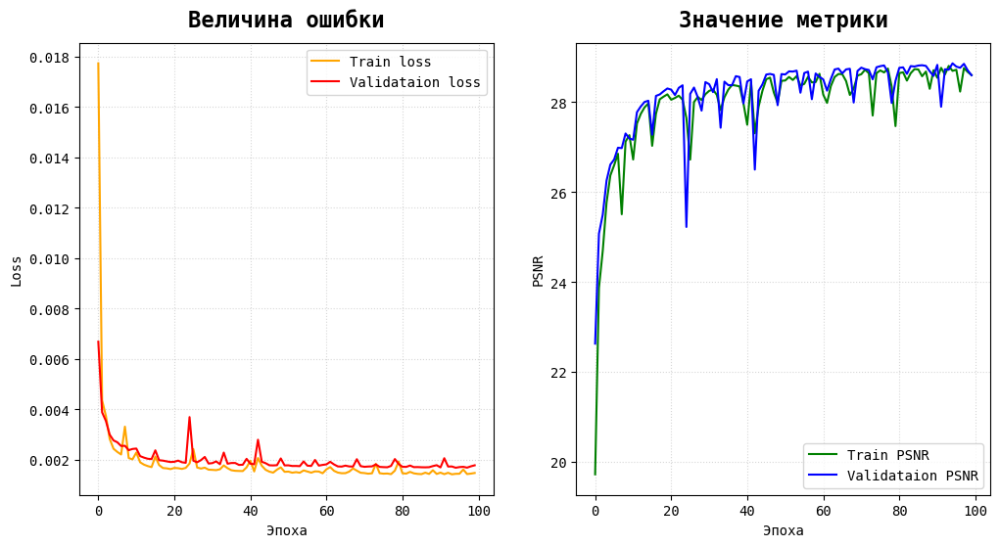

In [26]:
trainer.results.plot()

Иногда видны некоторые "скачки", однако общий тренд стремится к одному значению.

Среднее время обучения на одной эпохе составило:

In [27]:
trainer.results.summary()

Среднее время за эпоху: 0:00:09.351285


,Validation loss,Validation PSNR
Epoch,,
10,0.002423,27.189281
20,0.001904,28.300760
30,0.001844,28.442742
40,0.002030,27.969250
50,0.001770,28.620530
60,0.001790,28.558545
70,0.001741,28.689692
80,0.001825,28.469678
90,0.001779,28.579254


Легко увидеть, что наилучший результат достигнут на $70$ эпохе.

Следует визуально оценить качество модели. Здесь и далее будем использовать изображение бабочки из известного набора `Set5`. Для начала подгрузим модель $70$-ой эпохи:

In [28]:
trainer = Trainer_SRCNN.load_model('models/SRCNN/SRCNN/model_70.pth', 
                                   model, train_loader, val_loader, optimizer, 
                                   criterion, 
                                   output_path='models/SRCNN/SRCNN',
                                   is_divided=False,
                                   path_result='models/SRCNN/SRCNN/results.npy')

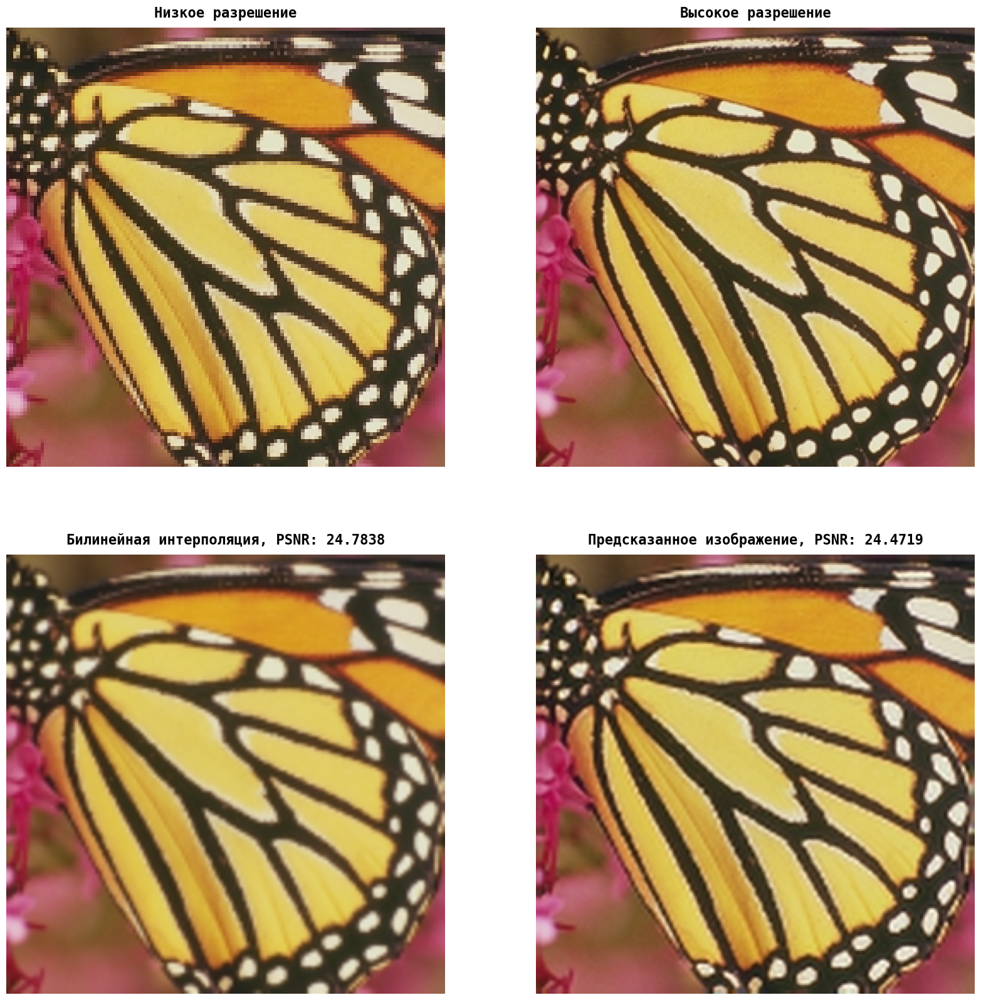

In [29]:
trainer.show_predict('data/Set5/butterfly.png')

На цифрах результат работы модели немного хуже, чем билинейная интерполяция, однако человеческому глазу может казаться, что модель справилась лучше.

Попробуем разбить изображения по каналам и обучить.

Преобразуем датасет:

In [30]:
dataset = CustomDataset('dataset/Raw Data/high_res', divide=True)

train_size = int(0.7 * len(dataset)) 
val_size = int(0.2 * len(dataset))
test_size = len(dataset) - train_size - val_size

torch.manual_seed(42)

train_set, val_set, test_set = random_split(dataset, 
                                            [train_size, val_size, test_size])

batch_size = 32
train_loader = DataLoader(train_set, batch_size=batch_size, shuffle=True)
val_loader = DataLoader(val_set, batch_size=batch_size, shuffle=False)
test_loader = DataLoader(test_set, batch_size=batch_size, shuffle=False)

In [31]:
model = SRCNN(in_channels=1).to(device)

optimizer = torch.optim.Adam(model.parameters(), lr=0.001)

criterion = nn.MSELoss()

In [109]:
trainer = Trainer_SRCNN(model, train_loader, val_loader, optimizer, criterion, 'models/SRCNN/SRCNN_div', is_divided=True)

In [ ]:
trainer.train()

LOSS 0.0014/0.0019 PSNR 29.1914/29.0814: 100%|██████████| 100/100 [33:22<00:00, 20.03s/it]


In [32]:
trainer = Trainer_SRCNN.load_model('models/SRCNN/SRCNN_div/model_100.pth', 
                                   model, train_loader, val_loader, optimizer, 
                                   criterion, 
                                   output_path='models/SRCNN/SRCNN_div', 
                                   is_divided=True,
                                   path_result='models/SRCNN/SRCNN_div/results.npy')

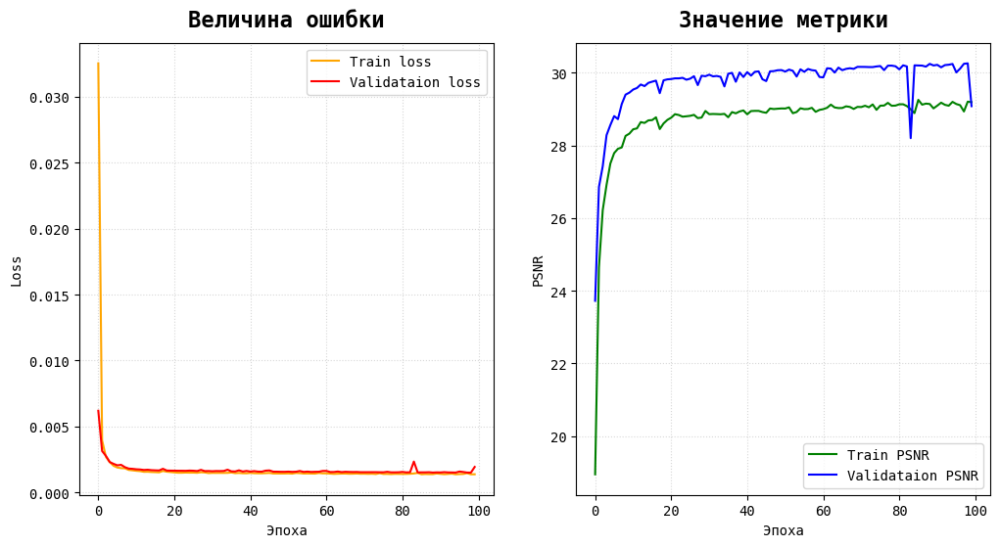

In [33]:
trainer.results.plot()

In [34]:
trainer.results.summary()

Среднее время за эпоху: 0:00:20.022802


,Validation loss,Validation PSNR
Epoch,,
10,0.001787,29.452829
20,0.001651,29.819045
30,0.001620,29.904966
40,0.001627,29.883402
50,0.001562,30.074601
60,0.001626,29.884888
70,0.001532,30.163006
80,0.001527,30.179266
90,0.001519,30.201465


Можем наблюдать, что выбранный подход изменил результаты модели в лучшую сторону. К сожалению, случился "скачок" на последней эпохе, из-за чего результат оказался хуже всех остальных. Однако по графику видно, что метрика медленно приближается к своему максимуму, поэтому можно сказать, что уже на $90$ эпохе она достигла своего пика.

Подгрузим соответствующую модель и оценим результат работы модели:

In [35]:
trainer = Trainer_SRCNN.load_model('models/SRCNN/SRCNN_div/model_90.pth', 
                                   model, train_loader, val_loader, optimizer, 
                                   criterion, 
                                   output_path='models/SRCNN/SRCNN_div', 
                                   is_divided=True,
                                   path_result='models/SRCNN/SRCNN_div/results.npy')

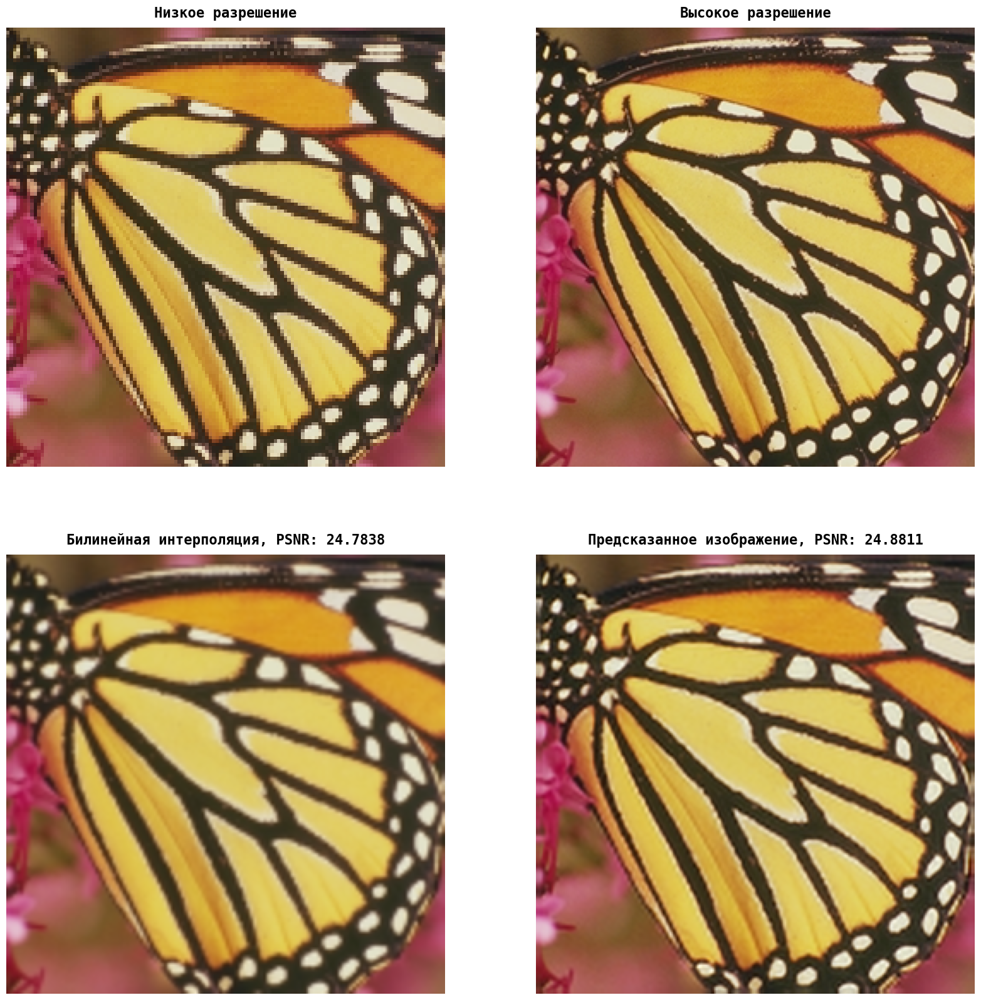

In [36]:
trainer.show_predict('data/Set5/butterfly.png')

Можно наблюдать, что результат стал чуть более сглаженным, нежели при обучении на трёхканальных изображениях. Однако стоит учесть, что из-за возросшего объёма датасета, время обучения каждой эпохи увеличилось в $2$ раза.

<style>
h1:after,
h2:after,
h3:after,
h4:after {
    position: absolute;
    content: "";
    left: 0;
    top: 0;
    bottom: 0;
    width: 5px;
    border-radius: 5px;
    box-shadow:
        inset 0 1px 1px rgba(0,0,0,0.5),
        0 1px 1px rgba(255,255,255,0.3);
}
 
h1:after { background: #aaf683; left: 0; padding: 0 0 0 10px;}
h2:after { background: #aaf683; left: 10px; padding: 0 0 0 5px;}
h3:after { background: #aaf683; left: 20px;}
h4:after { background: #aaf683; left: 30px;}
 
h1 {
    font-size: 36px;
    line-height: 40px;
    padding: 0 0 0 25px;
    margin: 1em 0 .6em 0;
    font-weight: normal;
    
    font-family: 'Hammersmith One', sans-serif;
    text-shadow: 1px 1px 2px rgba(0,0,0,0.4);
    position: relative;
}
 
h2 {
    margin: 1em 0 .6em 0;
    padding: 0 0 0 35px;
    font-weight: normal;
    
    font-family: 'Hammersmith One', sans-serif;
    text-shadow: 1px 1px 2px rgba(0,0,0,0.4);
    position: relative;
    font-size: 30px;
    line-height: 36px;
}
 
h3 {
    margin: 1em 0 .6em 0;
    padding: 0 0 0 40px;
    font-weight: normal;
    
    font-family: 'Hammersmith One', sans-serif;
    text-shadow: 1px 1px 2px rgba(0,0,0,0.4);
    position: relative;
    font-size: 24px;
    line-height: 32px;
    font-family: 'Questrial', sans-serif;
}
 
h4 {
    margin: 1em 0 .6em 0;
    padding: 0 0 0 50px;
    font-weight: normal;
    
    font-family: 'Hammersmith One', sans-serif;
    text-shadow: 1px 1px 2px rgba(0,0,0,0.4);
    position: relative;
    font-size: 18px;
    line-height: 28px;
    font-family: 'Questrial', sans-serif;
}
</style>

### <h3>Post-upsampling: FSRCNN</h3> <a class="anchor" id="main_train_fsrcnn"></a>

Как и было описано выше, `FSRCNN` позволяет добиться большого прироста в скорости за счёт его структуры $\text{post-upsampling}$, когда мы сначала на маленьком изображении применяем свёрточные слои, и только затем делаем $\text{upsampling}$.

Архитектура `FSRCNN` состоит из:

- Слой извлечения признаков $\text{feature extraction}$ с гиперпараметром $d$, регулирующим количество получаемых каналов. Используется ядро $5\text{x}5$.
- Слой сокращения $\text{shrinking}$, позволяющий перейти с помощью ядра $1\text{x}1$ от $d$ каналов к $s$.
- $m$ свёрточных слоёв с ядрами $3\text{x}3$.
- Слой расширения, переводящий результат обратно из $s$ каналов в $d$ с ядром $1\text{x}1$.
- Слой деконволюции $\text{upsampling}$, собственно повышающий размерность изображения.

In [37]:
class FSRCNN(nn.Module):
    def __init__(self, scale=2, in_channels=3):
        super().__init__()

        d = 56
        s = 16

        self.feature_extract = nn.Conv2d(in_channels=in_channels, out_channels=d, kernel_size=5, padding=2)
        nn.init.kaiming_normal_(self.feature_extract.weight)
        nn.init.zeros_(self.feature_extract.bias)

        self.activation_1 = nn.PReLU(num_parameters=d)

        self.shrink = nn.Conv2d(in_channels=d, out_channels=s, kernel_size=1)
        nn.init.kaiming_normal_(self.shrink.weight)
        nn.init.zeros_(self.shrink.bias)

        self.activation_2 = nn.PReLU(num_parameters=s)
        
        # m = 4
        self.map_1 = nn.Conv2d(in_channels=s, out_channels=s, kernel_size=3, padding=1)
        nn.init.kaiming_normal_(self.map_1.weight)
        nn.init.zeros_(self.map_1.bias)

        self.map_2 = nn.Conv2d(in_channels=s, out_channels=s, kernel_size=3, padding=1)
        nn.init.kaiming_normal_(self.map_2.weight)
        nn.init.zeros_(self.map_2.bias)

        self.map_3 = nn.Conv2d(in_channels=s, out_channels=s, kernel_size=3, padding=1)
        nn.init.kaiming_normal_(self.map_3.weight)
        nn.init.zeros_(self.map_3.bias)

        self.map_4 = nn.Conv2d(in_channels=s, out_channels=s, kernel_size=3, padding=1)
        nn.init.kaiming_normal_(self.map_4.weight)
        nn.init.zeros_(self.map_4.bias)

        self.activation_3 = nn.PReLU(num_parameters=s)

        self.expand = nn.Conv2d(in_channels=s, out_channels=d, kernel_size=1)
        nn.init.kaiming_normal_(self.expand.weight)
        nn.init.zeros_(self.expand.bias)

        self.activation_4 = nn.PReLU(num_parameters=d)

        self.deconv = nn.ConvTranspose2d(in_channels=d, out_channels=in_channels, kernel_size=9, 
                                        stride=scale, padding=4, output_padding=scale-1)
        nn.init.normal_(self.deconv.weight, mean=0.0, std=0.001)
        nn.init.zeros_(self.deconv.bias)

    def forward(self, x):
        x = self.feature_extract(x)
        x = self.activation_1(x)

        x = self.shrink(x)
        x = self.activation_2(x)

        x = self.map_1(x)
        x = self.map_2(x)
        x = self.map_3(x)
        x = self.map_4(x)
        x = self.activation_3(x)

        x = self.expand(x)
        x = self.activation_4(x)

        x = self.deconv(x)
        x = torch.clip(x, 0.0, 1.0)

        return x

Восстановим исходный датасет:

In [38]:
dataset = CustomDataset('dataset/Raw Data/high_res')

train_size = int(0.7 * len(dataset)) 
val_size = int(0.2 * len(dataset))
test_size = len(dataset) - train_size - val_size

torch.manual_seed(42)

train_set, val_set, test_set = random_split(dataset, 
                                            [train_size, val_size, test_size])

batch_size = 32
train_loader = DataLoader(train_set, batch_size=batch_size, shuffle=True)
val_loader = DataLoader(val_set, batch_size=batch_size, shuffle=False)
test_loader = DataLoader(test_set, batch_size=batch_size, shuffle=False)

In [39]:
model = FSRCNN().to(device)

optimizer = torch.optim.Adam(model.parameters(), lr=0.001)

criterion = nn.MSELoss()

In [118]:
trainer = Trainer_SRCNN(model, train_loader, val_loader, optimizer, criterion, 'models/FSRCNN/FSRCNN')

Так как обучение данной модели действительно быстрое, возьмём $300$ эпох и взглянем на результат.

In [60]:
trainer.train(num_epochs=300)

LOSS 0.0010/0.0013 PSNR 30.4876/32.8143: 100%|██████████| 300/300 [21:13<00:00,  4.24s/it]


In [40]:
trainer = Trainer_SRCNN.load_model('models/FSRCNN/FSRCNN/model_300.pth', model, 
                                   train_loader, val_loader, optimizer, 
                                   criterion, 
                                   output_path='models/FSRCNN/FSRCNN', 
                                   path_result='models/FSRCNN/FSRCNN/results.npy')

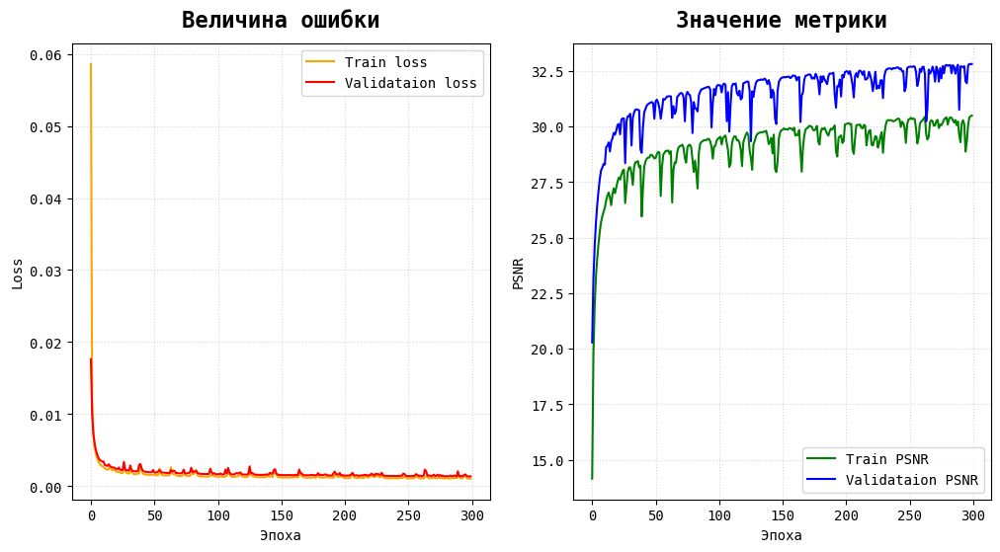

In [41]:
trainer.results.plot()

In [42]:
trainer.results.summary()

Среднее время за эпоху: 0:00:04.239617


,Validation loss,Validation PSNR
Epoch,,
10,0.003390,28.312773
20,0.002492,29.816994
30,0.002189,30.449963
40,0.003052,28.813159
50,0.002231,30.348675
60,0.001821,31.345650
70,0.001773,31.473053
80,0.002544,29.699184
90,0.001680,31.736295


По метрике легко видеть, что модель медленно улучшается, однако на $100$ эпохе уже достигла отличного результата. Безусловно, лучше моделью оказалось та, что обучилась $300$ эпох, с отрывом в $1$ единицу метрики `PSNR`. Также нельзя не отметить ускорение более чем в $2$ раза по сравнению с обычным `SRCNN`.

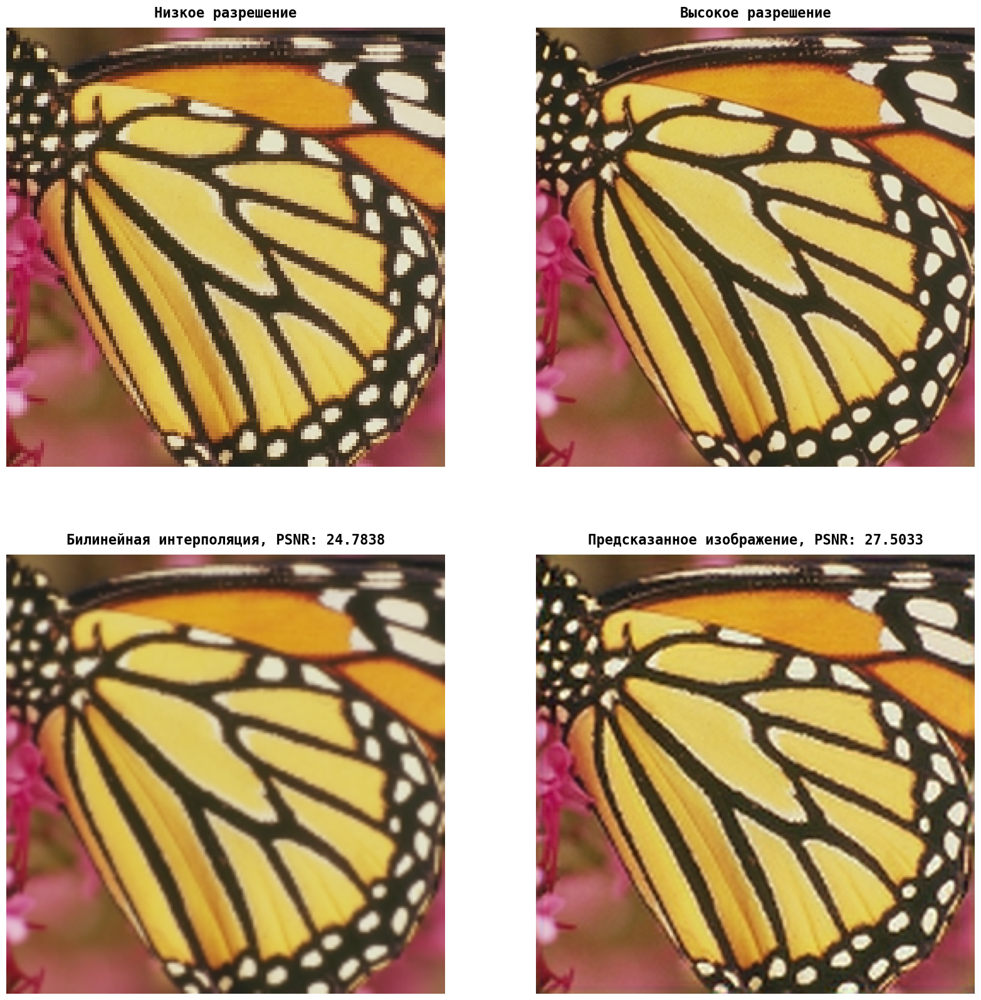

In [43]:
trainer.show_predict('data/Set5/butterfly.png')

Попробуем улучшить результат с помощью разбиения изображений по каналам:

In [44]:
dataset = CustomDataset('dataset/Raw Data/high_res', divide=True)

train_size = int(0.7 * len(dataset)) 
val_size = int(0.2 * len(dataset))
test_size = len(dataset) - train_size - val_size

torch.manual_seed(42)

train_set, val_set, test_set = random_split(dataset, 
                                            [train_size, val_size, test_size])

batch_size = 96
train_loader = DataLoader(train_set, batch_size=batch_size, shuffle=True)
val_loader = DataLoader(val_set, batch_size=batch_size, shuffle=False)
test_loader = DataLoader(test_set, batch_size=batch_size, shuffle=False)

In [45]:
model = FSRCNN(in_channels=1).to(device)

optimizer = torch.optim.Adam(model.parameters(), lr=0.001)

criterion = nn.MSELoss()

In [125]:
trainer = Trainer_SRCNN(model, train_loader, val_loader, optimizer, criterion, 'models/FSRCNN/FSRCNN_div')

In [13]:
trainer.train(num_epochs=300)

LOSS 0.2739/0.3025 PSNR 5.7957/6.4004: 100%|██████████| 300/300 [40:54<00:00,  8.18s/it]  


In [46]:
trainer = Trainer_SRCNN.load_model('models/FSRCNN/FSRCNN_div/model_300.pth', model, 
                                   train_loader, val_loader, optimizer, 
                                   criterion, 
                                   output_path='models/FSRCNN/FSRCNN_div', 
                                   is_divided=True,
                                   path_result='models/FSRCNN/FSRCNN_div/results.npy')

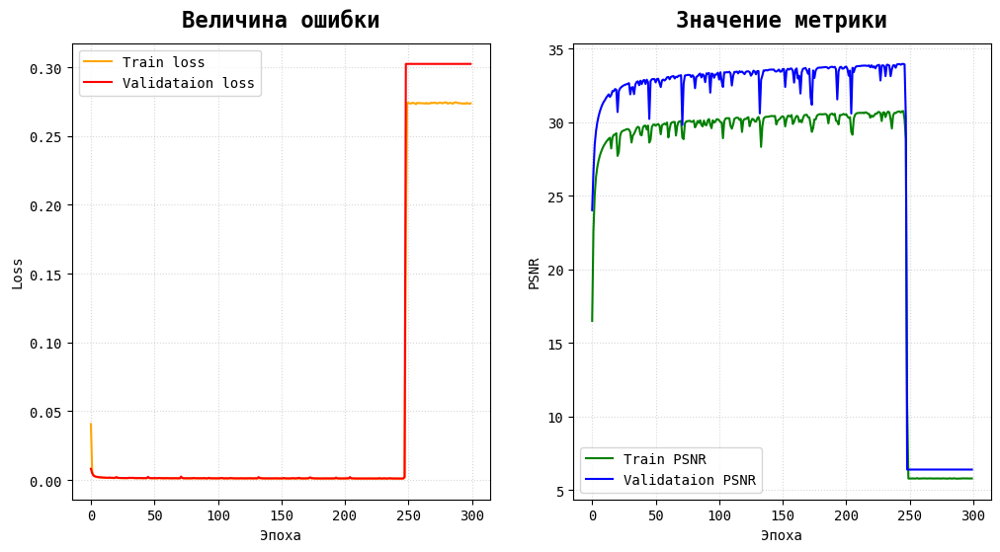

In [47]:
trainer.results.plot()

In [48]:
trainer.results.summary()

Среднее время за эпоху: 0:00:08.179250


,Validation loss,Validation PSNR
Epoch,,
10,0.001811,31.367436
20,0.001523,32.213056
30,0.001392,32.651821
40,0.001412,32.582791
50,0.001315,32.929939
60,0.001282,33.052755
70,0.001254,33.160371
80,0.001246,33.190696
90,0.001372,32.719883


В результате обучения после $240$ эпохи, вероятно, случилась ошибка оптимизатора, из-за чего параметры модели достигли локального минимума и не смогли покинуть его. Однако модель на $230$ эпохе показала наилучший результат, превосходящий результат модели на трёхканальных изображения ещё на одну единицу метрики `PSNR`. Из-за возросшего объёма датасета, модель обучалась в два раза дольше, однако всё равно быстрее, чем обычный `SRCNN`.

Подгрузим соответсвующую модель и посмотрим на результат:

In [49]:
trainer = Trainer_SRCNN.load_model('models/FSRCNN/FSRCNN_div/model_230.pth', model, 
                                   train_loader, val_loader, optimizer, 
                                   criterion, 
                                   output_path='models/FSRCNN/FSRCNN_div', 
                                   is_divided=True,
                                   path_result='models/FSRCNN/FSRCNN_div/results.npy')

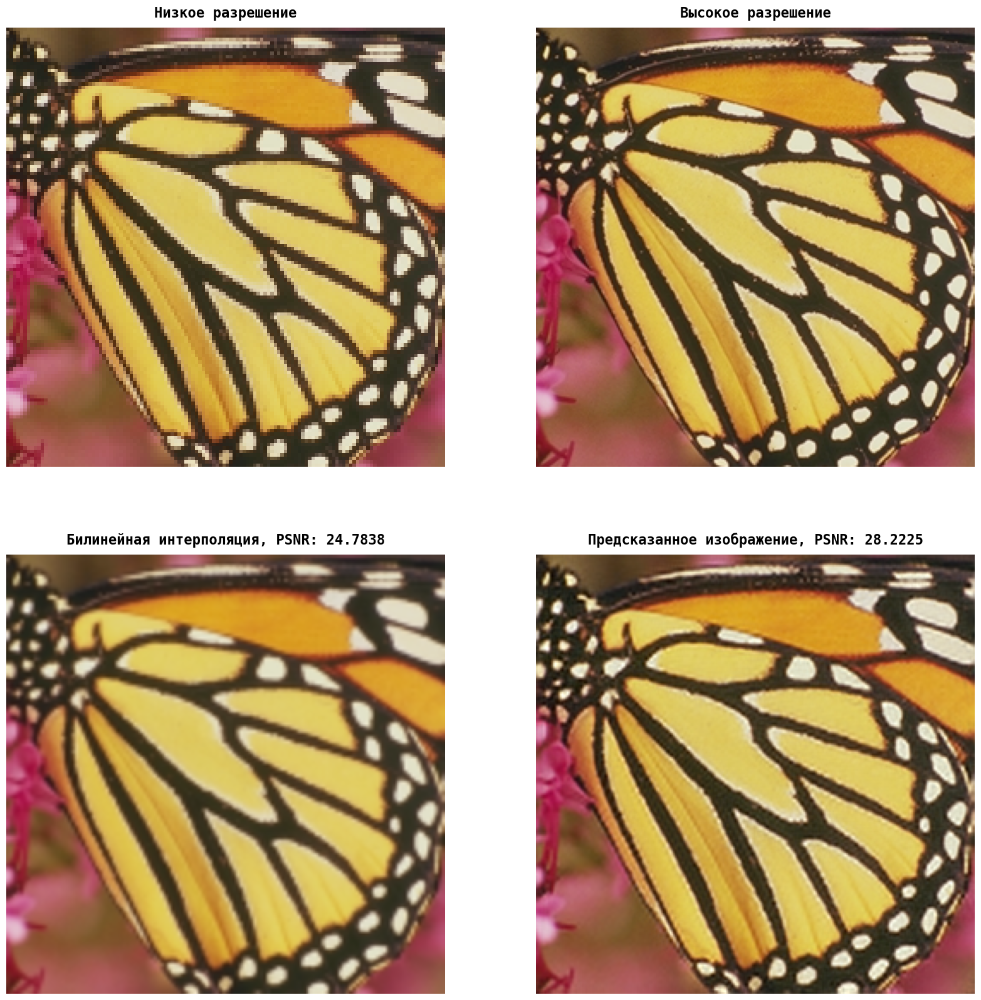

In [50]:
trainer.show_predict('data/Set5/butterfly.png')

Несложно наблюдать, что и по метрике, и визуально модель выдала результат лучше, чем билинейная интерполяция.

<style>
h1:after,
h2:after,
h3:after,
h4:after {
    position: absolute;
    content: "";
    left: 0;
    top: 0;
    bottom: 0;
    width: 5px;
    border-radius: 5px;
    box-shadow:
        inset 0 1px 1px rgba(0,0,0,0.5),
        0 1px 1px rgba(255,255,255,0.3);
}
 
h1:after { background: #aaf683; left: 0; padding: 0 0 0 10px;}
h2:after { background: #aaf683; left: 10px; padding: 0 0 0 5px;}
h3:after { background: #aaf683; left: 20px;}
h4:after { background: #aaf683; left: 30px;}
 
h1 {
    font-size: 36px;
    line-height: 40px;
    padding: 0 0 0 25px;
    margin: 1em 0 .6em 0;
    font-weight: normal;
    
    font-family: 'Hammersmith One', sans-serif;
    text-shadow: 1px 1px 2px rgba(0,0,0,0.4);
    position: relative;
}
 
h2 {
    margin: 1em 0 .6em 0;
    padding: 0 0 0 35px;
    font-weight: normal;
    
    font-family: 'Hammersmith One', sans-serif;
    text-shadow: 1px 1px 2px rgba(0,0,0,0.4);
    position: relative;
    font-size: 30px;
    line-height: 36px;
}
 
h3 {
    margin: 1em 0 .6em 0;
    padding: 0 0 0 40px;
    font-weight: normal;
    
    font-family: 'Hammersmith One', sans-serif;
    text-shadow: 1px 1px 2px rgba(0,0,0,0.4);
    position: relative;
    font-size: 24px;
    line-height: 32px;
    font-family: 'Questrial', sans-serif;
}
 
h4 {
    margin: 1em 0 .6em 0;
    padding: 0 0 0 50px;
    font-weight: normal;
    
    font-family: 'Hammersmith One', sans-serif;
    text-shadow: 1px 1px 2px rgba(0,0,0,0.4);
    position: relative;
    font-size: 18px;
    line-height: 28px;
    font-family: 'Questrial', sans-serif;
}
</style>

### <h3>GAN: SRGAN</h3> <a class="anchor" id="main_train_srgan"></a>

Из-за другой структуры модели объявим новые `Results` и `Trainer`:

In [51]:
class Results_GAN():
    def __init__(self, path):
        self.gen_train_loss = []
        self.gen_train_psnr = []
        self.gen_val_loss = []
        self.gen_val_psnr = []

        self.disc_train_loss = []
        self.disc_train_psnr = []
        self.disc_val_loss = []
        self.disc_val_psnr = []

        self.time = []
        self.path = path

    def update(self, gen_train_loss, gen_train_psnr, gen_val_loss, gen_val_psnr, 
               disc_train_loss, disc_train_psnr, disc_val_loss, disc_val_psnr, time):
        self.gen_train_loss.append(gen_train_loss)
        self.gen_train_psnr.append(gen_train_psnr)
        self.gen_val_loss.append(gen_val_loss)
        self.gen_val_psnr.append(gen_val_psnr)

        self.disc_train_loss.append(disc_train_loss)
        self.disc_train_psnr.append(disc_train_psnr)
        self.disc_val_loss.append(disc_val_loss)
        self.disc_val_psnr.append(disc_val_psnr)

        self.time.append(time)

        self.save()

    def __getitem__(self, index):
        return (self.gen_train_loss[index], self.gen_train_psnr[index], 
                self.gen_val_loss[index], self.gen_val_psnr[index], 
                self.disc_train_loss[index], self.disc_train_psnr[index], 
                self.disc_val_loss[index], self.disc_val_psnr[index], 
                self.time[index])
    
    def plot(self):
        fig, axes = plt.subplots(1, 2, figsize=(12, 6))

        fix_gen_train_loss = np.array([x.item() for x in self.gen_train_loss])

        axes[0].plot(fix_gen_train_loss, color='red', label='Generator train loss')
        axes[0].set_xlabel('Эпоха')
        axes[0].set_ylabel('Loss')
        axes[0].set_title('Величина ошибки')
        axes[0].grid(alpha=0.5, linestyle=':')
        axes[0].legend()

        axes[1].plot(self.gen_val_psnr, color='blue', label='Generator validataion PSNR')
        axes[1].set_xlabel('Эпоха')
        axes[1].set_ylabel('PSNR')
        axes[1].set_title('Значение метрики')
        axes[1].grid(alpha=0.5, linestyle=':')
        axes[1].legend()

        plt.show()

    def summary(self):
        fix_gen_train_loss = np.array([x.item() for x in self.gen_train_loss])

        data = pd.DataFrame([fix_gen_train_loss, self.gen_val_psnr]).T

        data.columns = ['Train loss', 'Validation PSNR']

        data = data.groupby(data.index // 10).last()

        data.index = (data.index + 1) * 10

        data.index.name = 'Epoch'

        print(f'Среднее время за эпоху: {np.mean(self.time)}')

        display(data.style
                .highlight_min('Train loss', axis=0, color='lightgreen')
                .highlight_max('Validation PSNR', axis=0, color='lightgreen'))

    def save(self):
        np.save(self.path, np.array([self.gen_train_loss, self.gen_val_loss, 
                                     self.gen_train_psnr, self.gen_val_psnr, 
                                     self.disc_train_loss, self.disc_val_loss,
                                     self.disc_train_psnr, self.disc_val_psnr,
                                     self.time]))

    @staticmethod
    def load(path):
        arr = np.load(path, allow_pickle=True)
        result = Results_GAN(path)
        result.gen_train_loss = arr[0, :]
        result.gen_val_loss = arr[1, :]
        result.gen_train_psnr = arr[2, :]
        result.gen_val_psnr = arr[3, :]
        result.disc_train_loss = arr[4, :]
        result.disc_val_loss = arr[5, :]
        result.disc_train_psnr = arr[6, :]
        result.disc_val_psnr = arr[7, :]
        result.time = arr[8, :]

        return result

In [52]:
class Trainer_SRGAN():
    def __init__(self, model_gen, model_disc, train_loader, val_loader, 
                 optimizer_gen, optimizer_disc, mse, bce, vgg_loss,
                 output_path='.', is_divided=False, path_result=None):
        self.gen = model_gen
        self.disc = model_disc
        self.train_loader = train_loader
        self.val_loader = val_loader
        self.optimizer_gen = optimizer_gen
        self.optimizer_disc = optimizer_disc
        self.mse = mse
        self.bce = bce
        self.vgg_loss = vgg_loss

        self.model = self.gen

        self.output_path = output_path

        self.is_divided = is_divided

        if path_result is None:
            path_result = os.path.join(self.output_path, 'results.npy')
            self.results = Results_GAN(path_result)
        else:
            self.results = Results_GAN.load(path_result)
        
    def train_model(self):
        self.gen.train()
        self.disc.train()

        disc_loss = 0
        gen_loss = 0

        for data in self.train_loader:
            high_res = data['high_img'].to(device)
            low_res = data['low_img'].to(device)
            
            ### Train Discriminator: max log(D(x)) + log(1 - D(G(z)))
            fake = self.gen(low_res)
            
            disc_real = self.disc(high_res)
            disc_fake = self.disc(fake.detach())
            
            disc_loss_real = self.bce(disc_real, torch.ones_like(disc_real))
            disc_loss_fake = self.bce(disc_fake, torch.zeros_like(disc_fake))
            
            disc_loss = disc_loss_fake + disc_loss_real

            self.optimizer_disc.zero_grad()
            disc_loss.backward()
            self.optimizer_disc.step()

            # Train Generator: min log(1 - D(G(z))) <-> max log(D(G(z))
            disc_fake = self.disc(fake)
            adversarial_loss = 1e-3 * self.bce(disc_fake, torch.ones_like(disc_fake))
            loss_for_vgg = 0.006 * self.vgg_loss(fake, high_res)
            gen_loss = loss_for_vgg + adversarial_loss

            self.optimizer_gen.zero_grad()
            gen_loss.backward()
            self.optimizer_gen.step()
        
        return gen_loss.cpu().detach(), disc_loss.cpu().detach()
    
    def validate_model(self, loader=None):
        self.gen.eval()
        
        if loader is None:
            loader = self.val_loader

        running_psnr = 0

        with torch.no_grad():
            for data in loader:
                image_data = data['low_img'].to(device)
                label = data['high_img'].to(device)
                
                outputs = self.gen(image_data)
                
                running_psnr += self.psnr(label, outputs)

        gen_psnr = running_psnr/len(loader.dataset) * loader.batch_size

        return None, gen_psnr
    
    def train(self, num_epochs=100, save_every=10):
        for epoch in (bar := tqdm(range(num_epochs))):
            time_last = dt.datetime.now()
            gen_loss, disc_loss = self.train_model()
            _, val_psnr = self.validate_model()
            self.results.update(gen_loss, None, None, val_psnr, 
                                disc_loss, None, None, None, dt.datetime.now() - time_last)
            if (epoch + 1) % save_every == 0:
                self.save_model(epoch + 1)
            bar.set_description(f"LOSS GEN {gen_loss:.4f} / DISC {disc_loss:.4f} PSNR {val_psnr:.4f}")

    def psnr(self, label, outputs, max_val=1.):
        if isinstance(label, torch.Tensor):
            label = label.cpu().detach().numpy()
        if isinstance(outputs, torch.Tensor):
            outputs = outputs.cpu().detach().numpy()
        diff = outputs - label
        rmse = np.sqrt(np.mean((diff) ** 2))
        if rmse == 0:
            return 100 # абсолютно индентичны
        else:
            PSNR = 20 * np.log10(max_val / rmse)
            return PSNR
    
    def save_model(self, epoch):
        torch.save(self.gen.state_dict(), os.path.join(self.output_path, f'model_gen_{epoch}.pth'))
        torch.save(self.disc.state_dict(), os.path.join(self.output_path, f'model_disc_{epoch}.pth'))

    def show_predict(self, path):
        fig, axes = plt.subplots(2, 2, figsize=(20, 20))

        self.gen.eval()

        high_img = cv2.imread(path).astype(np.float32) / 255
        high_img = cv2.cvtColor(high_img, cv2.COLOR_BGR2RGB)
        low_img = cv2.resize(high_img, (high_img.shape[0] // 2, high_img.shape[1] // 2))

        high_img = torch.Tensor(high_img).to(device).permute(2, 0, 1)
        low_img = torch.Tensor(low_img).to(device).permute(2, 0, 1)
        
        if not self.is_divided:
            outputs = self.gen(low_img[None, :, :, :])
        else:
            out = []
            for j in range(3):
                img = low_img[j][None, :, :]
                img = img.unsqueeze(0)
                outputs = self.model(img)
                outputs = outputs.cpu().detach()
                out.append(outputs.squeeze().numpy())
            outputs = torch.Tensor(np.array(out))

        outputs_psnr = self.psnr(high_img, outputs)
        bilinear_psnr = self.psnr(cv2.resize(low_img.permute(1, 2, 0).cpu().detach().numpy(), (256, 256)), high_img.squeeze().permute(1, 2, 0))
        
        axes[0, 0].imshow(low_img.cpu().permute(1, 2, 0))
        axes[0, 0].set_title('Низкое разрешение')
        axes[0, 0].axis('off')

        axes[1, 0].imshow(cv2.resize(low_img.cpu().permute(1, 2, 0).detach().numpy(), (256, 256)))
        axes[1, 0].set_title(f'Билинейная интерполяция, PSNR: {bilinear_psnr:.4f}')
        axes[1, 0].axis('off')

        axes[1, 1].imshow(np.clip(outputs.squeeze().cpu().detach().permute(1, 2, 0), 0, 1))
        axes[1, 1].set_title(f'Предсказанное изображение, PSNR: {outputs_psnr:.4f}')
        axes[1, 1].axis('off')

        axes[0, 1].imshow(high_img.cpu().permute(1, 2, 0))
        axes[0, 1].set_title('Высокое разрешение')
        axes[0, 1].axis('off')

        plt.show()

    @staticmethod
    def load_model(path_gen, path_disc, model_gen, model_disc, train_loader, val_loader, 
                 optimizer_gen, optimizer_disc, mse, bce, vgg_loss,
                 output_path='.', is_divided=False, path_result=None):

        model_gen = model_gen.to(device)
        model_gen.load_state_dict(torch.load(path_gen))
        model_disc = model_disc.to(device)
        model_disc.load_state_dict(torch.load(path_disc))

        return Trainer_SRGAN(model_gen, model_disc, train_loader, val_loader, 
                 optimizer_gen, optimizer_disc, mse, bce, vgg_loss,
                 output_path, is_divided, path_result)

В качестве особой функции потерь будет использоваться предобученная модель `vgg-19`, обученная на $1$ млн изображений из $\text{ImageNet}$.

In [53]:
from torchvision.models import vgg19, VGG19_Weights

Объявим структурные элементы модели:

- `ConvBlock`, отвечающий за свёрточный слой с нормализацией и функцией активации.
- `UpsampleBlock`, позволяющий повысить размер изображения.
- `ResidualBlock`, соединяющий два блока свёртки с исходнымы данными.
- Собственно `Generator` и `Discriminator`, состоящие из набора блоков выше.

In [54]:
class vggL(nn.Module):
    def __init__(self):
        super().__init__()
        self.vgg = vgg19(weights=VGG19_Weights.IMAGENET1K_V1).features[:25].eval().to(device)
        self.loss = nn.MSELoss()

    def forward(self, first, second):
        vgg_first = self.vgg(first)
        vgg_second = self.vgg(second)
        perceptual_loss = self.loss(vgg_first, vgg_second)
        return perceptual_loss
    
class ConvBlock(nn.Module):
    # Conv -> BN -> leakyReLU
    def __init__(
            self,
            in_channels,
            out_channels,
            use_activation=True,
            use_BatchNorm=True,
            **kwargs
    ):
        
        super().__init__()
        self.use_activation = use_activation
        self.cnn = nn.Conv2d(in_channels, out_channels, **kwargs)
        self.bn = nn.BatchNorm2d(out_channels) if use_BatchNorm else nn.Identity()
        self.ac = (
            nn.LeakyReLU(0.2, inplace=True)
        )

    def forward(self, x):
        x1 = self.cnn(x)
        x2 = self.bn(x1)
        x3 = self.ac(x2)
        return x3 if self.use_activation else x2
    
class UpsampleBlock(nn.Module):
    def __init__(self, in_channels, scale_factor):
        super().__init__()
        self.conv = nn.Conv2d(in_channels, in_channels * scale_factor ** 2, 2, 1, 1)
        self.ps = nn.PixelShuffle(scale_factor)
        self.ac = nn.PReLU(num_parameters=in_channels)

    def forward(self, x):
        return self.ac(self.ps(self.conv(x)))
    
class ResidualBlock(nn.Module):
    def __init__(self, in_channels):
        super().__init__()
        self.b1 = ConvBlock(
            in_channels,
            in_channels,
            kernel_size=3,
            stride=1,
            padding=1
        )

        self.b2 = ConvBlock(
            in_channels,
            in_channels,
            kernel_size=3,
            stride=1,
            padding=1,
            use_activation=False
        )

    def forward(self, x):
        out = self.b1(x)
        out = self.b2(out)
        return out + x
    
class Generator(nn.Module):
    def __init__(self, in_channels=3, num_channels=64, num_blocks=8):
        super().__init__()
        self.initial = ConvBlock(in_channels, num_channels, kernel_size=7, stride=1, padding=4, use_BatchNorm=False)
        self.res = nn.Sequential(*[ResidualBlock(num_channels) for i in range(num_blocks)])
        self.conv = ConvBlock(num_channels, num_channels, kernel_size=3, stride=1, padding=1, use_activation=False)
        self.up = nn.Sequential(UpsampleBlock(num_channels, scale_factor=2)) 
        self.final = nn.Conv2d(num_channels, in_channels, kernel_size=9, stride=1, padding=1)

    def forward(self, x):
        x = self.initial(x)
        c = self.res(x)
        c = self.conv(c) + x
        c = self.up(c)
        return torch.sigmoid(self.final(c))
    
class Discriminator(nn.Module):
    def __init__(self, in_channels=3, features=[64, 64, 128, 128, 256, 256, 512, 512]):
        super().__init__()
        blocks = []
        for idx, feature in enumerate(features):
            blocks.append(
                ConvBlock(
                    in_channels,
                    feature,
                    kernel_size=3,
                    stride = idx % 2 + 1,
                    padding=1,
                    use_activation=True,
                    use_BatchNorm=idx != 0,
                )
            )
            in_channels = feature

        self.blocks = nn.Sequential(*blocks)

        self.mlp = nn.Sequential(
            nn.AdaptiveAvgPool2d((8, 8)),
            nn.Flatten(),
            nn.Linear(512*8*8, 1024),
            nn.LeakyReLU(0.2, inplace=True),
            nn.Linear(1024, 1)
        )

    def forward(self, x):
        x = self.blocks(x)
        x = self.mlp(x)
        return x

Так как обучение генеративной модели слишком времязатратно, будем использовать предобученный [чекпоинт](https://www.kaggle.com/code/minawagihsmikhael/srgan-image-super-resolution-pytorch/output?select=checkpoint1_gen) на $30$ эпохах. Поэтому обучим модель ещё $70$ эпох:

In [55]:
gen = Generator(in_channels=3).to(device)
gen.load_state_dict(torch.load('data/checkpoint1_gen'))

disc = Discriminator(in_channels=3).to(device)
disc.load_state_dict(torch.load('data/checkpoint1_disc'))

opt_gen = torch.optim.Adam(gen.parameters(), lr=3e-4, betas=(0.9, 0.999))
opt_disc = torch.optim.Adam(disc.parameters(), lr=3e-4, betas=(0.9, 0.999))

mse = nn.MSELoss()
bce = nn.BCEWithLogitsLoss()
vgg_loss = vggL()

In [135]:
trainer = Trainer_SRGAN(gen, disc, train_loader, val_loader, opt_gen, opt_disc, mse, bce, vgg_loss, 'models/SRGAN')

In [61]:
trainer.train(num_epochs=70)

LOSS GEN 0.0144 / DISC 0.2172 PSNR 23.5976: 100%|██████████| 70/70 [3:40:54<00:00, 189.34s/it]  


In [56]:
trainer = Trainer_SRGAN.load_model('models/SRGAN/model_gen_70.pth', 
                                   'models/SRGAN/model_disc_70.pth', 
                                   gen, disc, train_loader, val_loader,
                                   opt_gen, opt_disc, mse, bce, vgg_loss,
                                   output_path='models/SRGAN',
                                   path_result='models/SRGAN/results.npy')

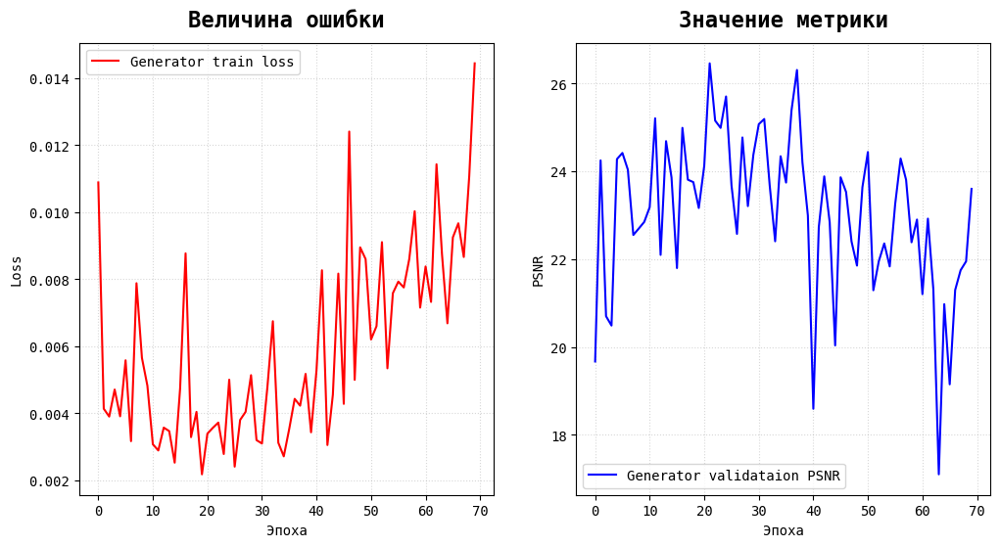

In [57]:
trainer.results.plot()

In [58]:
trainer.results.summary()

Среднее время за эпоху: 0:03:09.300724


,Train loss,Validation PSNR
Epoch,,
10,0.004817,22.844762
20,0.002174,23.161768
30,0.003194,24.369626
40,0.003428,22.989358
50,0.008594,23.635863
60,0.007147,22.898237
70,0.014433,23.597554


Несложно увидеть, почему генеративные модели сложны в обучении: они слишком нестабильны и занимают относительно много времени. Наилучшей моделью по метрике оказалась модель $30$-ой эпохи, однако по величине ошибки - $20$-ая. Взглянем на результат двадцатой эпохи:

In [59]:
trainer = Trainer_SRGAN.load_model('models/SRGAN/model_gen_20.pth', 
                                   'models/SRGAN/model_disc_20.pth', 
                                   gen, disc, train_loader, val_loader,
                                   opt_gen, opt_disc, mse, bce, vgg_loss,
                                   output_path='models/SRGAN',
                                   path_result='models/SRGAN/results.npy')

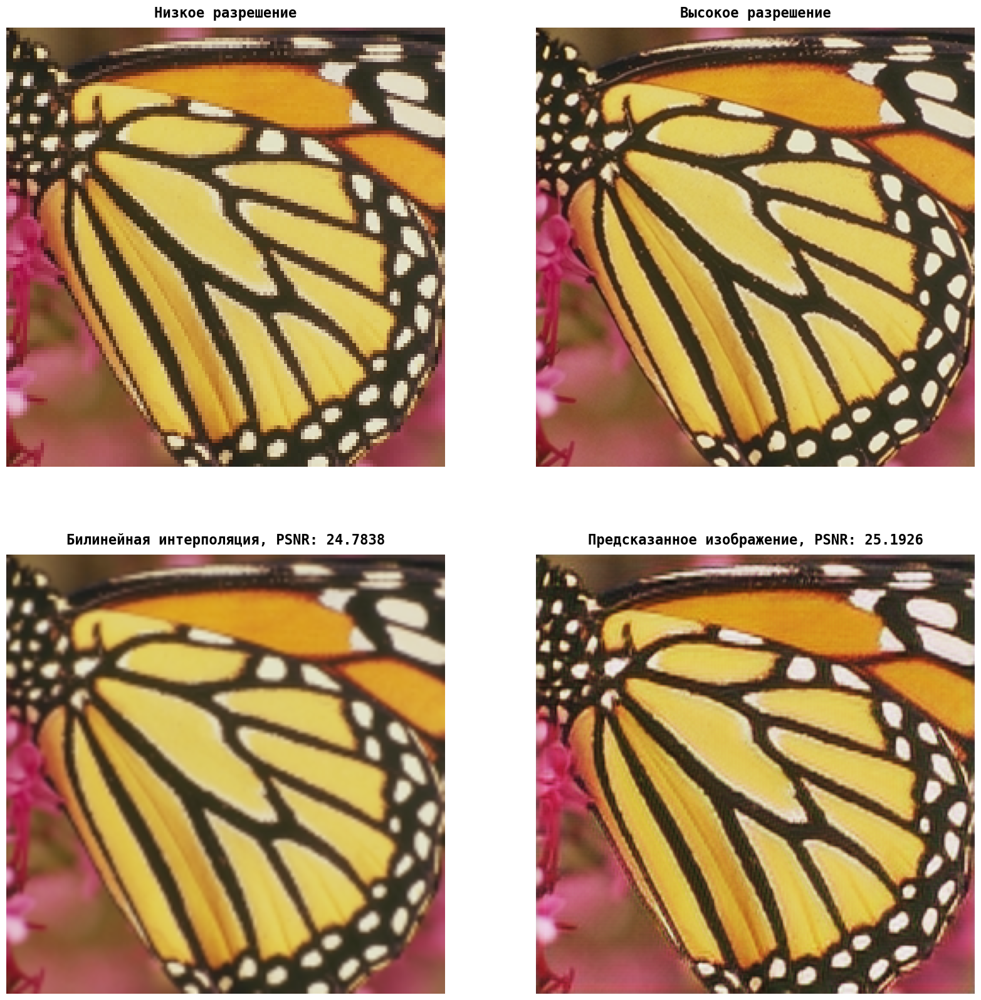

In [60]:
trainer.show_predict('data/Set5/butterfly.png')

По метрике видно, что модель максимально близка к билинейной интерполяции, однако оценивая визуально можно сказать, что `SRGAN` справился лучше.

<style>
h1:after,
h2:after,
h3:after,
h4:after {
    position: absolute;
    content: "";
    left: 0;
    top: 0;
    bottom: 0;
    width: 5px;
    border-radius: 5px;
    box-shadow:
        inset 0 1px 1px rgba(0,0,0,0.5),
        0 1px 1px rgba(255,255,255,0.3);
}
 
h1:after { background: #aaf683; left: 0; padding: 0 0 0 10px;}
h2:after { background: #aaf683; left: 10px; padding: 0 0 0 5px;}
h3:after { background: #aaf683; left: 20px;}
h4:after { background: #aaf683; left: 30px;}
 
h1 {
    font-size: 36px;
    line-height: 40px;
    padding: 0 0 0 25px;
    margin: 1em 0 .6em 0;
    font-weight: normal;
    
    font-family: 'Hammersmith One', sans-serif;
    text-shadow: 1px 1px 2px rgba(0,0,0,0.4);
    position: relative;
}
 
h2 {
    margin: 1em 0 .6em 0;
    padding: 0 0 0 35px;
    font-weight: normal;
    
    font-family: 'Hammersmith One', sans-serif;
    text-shadow: 1px 1px 2px rgba(0,0,0,0.4);
    position: relative;
    font-size: 30px;
    line-height: 36px;
}
 
h3 {
    margin: 1em 0 .6em 0;
    padding: 0 0 0 40px;
    font-weight: normal;
    
    font-family: 'Hammersmith One', sans-serif;
    text-shadow: 1px 1px 2px rgba(0,0,0,0.4);
    position: relative;
    font-size: 24px;
    line-height: 32px;
    font-family: 'Questrial', sans-serif;
}
 
h4 {
    margin: 1em 0 .6em 0;
    padding: 0 0 0 50px;
    font-weight: normal;
    
    font-family: 'Hammersmith One', sans-serif;
    text-shadow: 1px 1px 2px rgba(0,0,0,0.4);
    position: relative;
    font-size: 18px;
    line-height: 28px;
    font-family: 'Questrial', sans-serif;
}
</style>

## <h2>Итоговое сравнение</h2> <a class="anchor" id="main_comparing"></a>

Наконец, приступим к итоговому сравнению. В качестве оценки метрики будем использовать оставшуюся тестовую часть изначально датасета, а на экран выведем изображение бабочки. 

In [61]:
class Summary():
    def __init__(self, test_loader, test_loader_div, picture):
        self.results = []
        self.test_loader = test_loader
        self.test_loader_div = test_loader_div
        self.picture = picture

    def add_result(self, name, trainer):
        self.results.append({'name': name, 'trainer': trainer})

    def summary_table(self):
        data = []

        for result in tqdm(self.results, leave=False):
            time_compute = dt.datetime.now()
            loader = self.test_loader_div if result['trainer'].is_divided else self.test_loader
            loss, psnr = result['trainer'].validate_model(loader)
            time_compute = (dt.datetime.now() - time_compute).total_seconds()
            data.append([loss, np.round(psnr, 2), np.round(time_compute, 3), 
                         np.round(np.mean(result['trainer'].results.time).total_seconds(), 3)])
            
        df = pd.DataFrame(np.array(data), 
                          columns=['Loss', 'PSNR', 'Время вычисления, сек', 'Время обучения (1 эпоха), сек'],
                          index=[i['name'] for i in self.results])
        
        df.index.name = 'Модель'

        styler = df.astype(float).style
        
        styler.background_gradient(cmap='RdYlGn_r', subset=['Loss', 'Время вычисления, сек', 'Время обучения (1 эпоха), сек'])

        styler.background_gradient(cmap='RdYlGn', subset='PSNR')

        styler.format(subset='PSNR', precision=2)

        styler.format(subset='Время вычисления, сек', precision=3)
        
        styler.format(subset='Время обучения (1 эпоха), сек', precision=3)

        display(styler)

    def summary_picture(self, cropx=None, cropy=None):
        high_img = cv2.imread(self.picture).astype(np.float32) / 255
        high_img = cv2.cvtColor(high_img, cv2.COLOR_BGR2RGB)
        low_img = cv2.resize(high_img, (high_img.shape[0] // 2, high_img.shape[1] // 2))

        if cropx is None:
            cropx = (0, high_img.shape[0])
        
        if cropy is None:
            cropy = (0, high_img.shape[1])

        high_img = torch.Tensor(high_img).to(device).permute(2, 0, 1)
        low_img = torch.Tensor(low_img).to(device).permute(2, 0, 1)

        n = len(self.results)

        n = n // 4 + (1 if n % 4 else 0)

        fig, axes = plt.subplots(n + 1, 4, figsize=(4 * 7, (n + 1) * 7))

        for i, result in enumerate(self.results):
            trainer = result['trainer']

            trainer.model.eval()

            if not trainer.is_divided:
                output = trainer.model(low_img[None, :, :, :])
            else:
                out = []
                for j in range(3):
                    img = low_img[j][None, :, :]
                    img = img.unsqueeze(0)
                    output = trainer.model(img)
                    output = output.cpu().detach()
                    out.append(output.squeeze().numpy())
                output = torch.Tensor(np.array(out))

            output_psnr = trainer.psnr(high_img, output)
            bilinear_psnr = trainer.psnr(cv2.resize(low_img.permute(1, 2, 0).cpu().detach().numpy(), (256, 256)), high_img.squeeze().permute(1, 2, 0))
            lanczos_psnr = trainer.psnr(cv2.resize(low_img.permute(1, 2, 0).cpu().detach().numpy(), (256, 256), interpolation=cv2.INTER_LANCZOS4), high_img.squeeze().permute(1, 2, 0))

            ax = plt.subplot(n + 1, 4, i + 1 + 4)

            ax.imshow(np.clip(output.squeeze().cpu().detach().permute(1, 2, 0), 0, 1)[cropx[0]:cropx[1], cropy[0]:cropy[1], :])
            ax.set_title(f'{result["name"]} | {output_psnr:.4f}')
            ax.axis('off')
            

        axes[0, 0].imshow(low_img.cpu().permute(1, 2, 0)[cropx[0]//2:cropx[1]//2, cropy[0]//2:cropy[1]//2, :])
        axes[0, 0].set_title('Низкое разрешение')
        axes[0, 0].axis('off')

        axes[0, 1].imshow(cv2.resize(low_img.cpu().permute(1, 2, 0).detach().numpy(), (256, 256))[cropx[0]:cropx[1], cropy[0]:cropy[1], :])
        axes[0, 1].set_title(f'Билинейная интерполяция | {bilinear_psnr:.4f}')
        axes[0, 1].axis('off')

        axes[0, 2].imshow(np.clip(cv2.resize(low_img.cpu().permute(1, 2, 0).detach().numpy(), (256, 256), interpolation=cv2.INTER_LANCZOS4), 0, 1)[cropx[0]:cropx[1], cropy[0]:cropy[1], :])
        axes[0, 2].set_title(f'Интерполяция Ланцоша | {lanczos_psnr:.4f}')
        axes[0, 2].axis('off')

        axes[0, 3].imshow(high_img.cpu().permute(1, 2, 0)[cropx[0]:cropx[1], cropy[0]:cropy[1], :])
        axes[0, 3].set_title('Высокое разрешение')
        axes[0, 3].axis('off')

        plt.show()

In [62]:
dataset = CustomDataset('dataset/Raw Data/high_res')

train_size = int(0.7 * len(dataset)) 
val_size = int(0.2 * len(dataset))
test_size = len(dataset) - train_size - val_size

torch.manual_seed(42)

train_set, val_set, test_set = random_split(dataset, 
                                            [train_size, val_size, test_size])

batch_size = 32
test_loader = DataLoader(test_set, batch_size=batch_size, shuffle=False)

dataset = CustomDataset('dataset/Raw Data/high_res', divide=True)

train_size = int(0.7 * len(dataset)) 
val_size = int(0.2 * len(dataset))
test_size = len(dataset) - train_size - val_size

torch.manual_seed(42)

train_set, val_set, test_set = random_split(dataset, 
                                            [train_size, val_size, test_size])

batch_size = 32
test_loader_div = DataLoader(test_set, batch_size=batch_size, shuffle=False)

In [63]:
summary = Summary(test_loader, test_loader_div, 'data/Set5/butterfly.png')

In [64]:
model = SRCNN(in_channels=3).to(device)

optimizer = torch.optim.Adam(model.parameters(), lr=0.001)

criterion = nn.MSELoss()

summary.add_result('SRCNN / 3 канала / 70 эпоха', Trainer_SRCNN.load_model('models/SRCNN/SRCNN/model_70.pth', 
                                   model, train_loader, val_loader, optimizer, 
                                   criterion, 
                                   output_path='models/SRCNN/SRCNN',
                                   is_divided=False,
                                   path_result='models/SRCNN/SRCNN/results.npy'))

In [65]:
model = SRCNN(in_channels=1).to(device)

summary.add_result('SRCNN / 1 канал / 90 эпоха', Trainer_SRCNN.load_model('models/SRCNN/SRCNN_div/model_90.pth', 
                                   model, train_loader, val_loader, optimizer, 
                                   criterion, 
                                   output_path='models/SRCNN/SRCNN_div', 
                                   is_divided=True,
                                   path_result='models/SRCNN/SRCNN_div/results.npy'))

In [66]:
model = FSRCNN(in_channels=3).to(device)

summary.add_result('FSRCNN / 3 канала / 100 эпоха', Trainer_SRCNN.load_model('models/FSRCNN/FSRCNN/model_100.pth', model, 
                                   train_loader, val_loader, optimizer, 
                                   criterion, 
                                   output_path='models/FSRCNN/FSRCNN', 
                                   path_result='models/FSRCNN/FSRCNN/results.npy'))

In [67]:
model = FSRCNN(in_channels=3).to(device)

summary.add_result('FSRCNN / 3 канала / 300 эпоха', Trainer_SRCNN.load_model('models/FSRCNN/FSRCNN/model_300.pth', model, 
                                   train_loader, val_loader, optimizer, 
                                   criterion, 
                                   output_path='models/FSRCNN/FSRCNN', 
                                   path_result='models/FSRCNN/FSRCNN/results.npy'))

In [68]:
model = FSRCNN(in_channels=1).to(device)

summary.add_result('FSRCNN / 1 канал / 100 эпоха', Trainer_SRCNN.load_model('models/FSRCNN/FSRCNN_div/model_100.pth', model, 
                                   train_loader, val_loader, optimizer, 
                                   criterion, 
                                   output_path='models/FSRCNN/FSRCNN_div', 
                                   is_divided=True,
                                   path_result='models/FSRCNN/FSRCNN_div/results.npy'))

In [69]:
model = FSRCNN(in_channels=1).to(device)

summary.add_result('FSRCNN / 1 канал / 230 эпоха', Trainer_SRCNN.load_model('models/FSRCNN/FSRCNN_div/model_230.pth', model, 
                                   train_loader, val_loader, optimizer, 
                                   criterion, 
                                   output_path='models/FSRCNN/FSRCNN_div', 
                                   is_divided=True,
                                   path_result='models/FSRCNN/FSRCNN_div/results.npy'))

In [70]:
gen = Generator(in_channels=3).to(device)

disc = Discriminator(in_channels=3).to(device)

opt_gen = torch.optim.Adam(gen.parameters(), lr=3e-4, betas=(0.9, 0.999))
opt_disc = torch.optim.Adam(disc.parameters(), lr=3e-4, betas=(0.9, 0.999))

mse = nn.MSELoss()
bce = nn.BCEWithLogitsLoss()
vgg_loss = vggL()

summary.add_result('SRGAN / 3 канала / 50 эпоха', Trainer_SRGAN.load_model('models/SRGAN/model_gen_20.pth', 
                                   'models/SRGAN/model_disc_20.pth', 
                                   gen, disc, train_loader, val_loader,
                                   opt_gen, opt_disc, mse, bce, vgg_loss,
                                   output_path='models/SRGAN',
                                   path_result='models/SRGAN/results.npy'))

In [71]:
gen = Generator(in_channels=3).to(device)

disc = Discriminator(in_channels=3).to(device)

opt_gen = torch.optim.Adam(gen.parameters(), lr=3e-4, betas=(0.9, 0.999))
opt_disc = torch.optim.Adam(disc.parameters(), lr=3e-4, betas=(0.9, 0.999))

mse = nn.MSELoss()
bce = nn.BCEWithLogitsLoss()
vgg_loss = vggL()

summary.add_result('SRGAN / 3 канала / 60 эпоха', Trainer_SRGAN.load_model('models/SRGAN/model_gen_30.pth', 
                                   'models/SRGAN/model_disc_30.pth', 
                                   gen, disc, train_loader, val_loader,
                                   opt_gen, opt_disc, mse, bce, vgg_loss,
                                   output_path='models/SRGAN',
                                   path_result='models/SRGAN/results.npy'))

Рассмотрим статистику на тестовом наборе данных:

In [72]:
summary.summary_table()

,Loss,PSNR,"Время вычисления, сек","Время обучения (1 эпоха), сек"
Модель,,,,
SRCNN / 3 канала / 70 эпоха,0.001683,31.50,3.896,9.351
SRCNN / 1 канал / 90 эпоха,0.001433,32.45,0.989,20.023
FSRCNN / 3 канала / 100 эпоха,0.001400,32.40,0.335,4.240
FSRCNN / 3 канала / 300 эпоха,0.001149,33.35,0.252,4.240
FSRCNN / 1 канал / 100 эпоха,0.001096,33.76,0.427,8.179
FSRCNN / 1 канал / 230 эпоха,0.000982,34.30,0.427,8.179
SRGAN / 3 канала / 50 эпоха,nan,24.35,15.331,189.301
SRGAN / 3 канала / 60 эпоха,nan,27.50,13.982,189.301


Несложно увидеть, что наилучший результат показывают модели семейства `FSRCNN`, причём обученные на $1$-канальных изображениях взамен большего количества времени на вычисление и обучения получают лучшую эффективность.

Модели `SRCNN` явно проигрывают на фоне `FSRCNN`, являясь, по сути, средним звеном в этой таблице.

Наихудший результат показывают генеративные модели по всем показателям, однако с учётом их потенциала они всё равно имеют право на существование.

Никакие цифры точно не покажут эффективность алгоритма по сравнению с человеческим глазом, поэтому оценим работу моделей визуально:

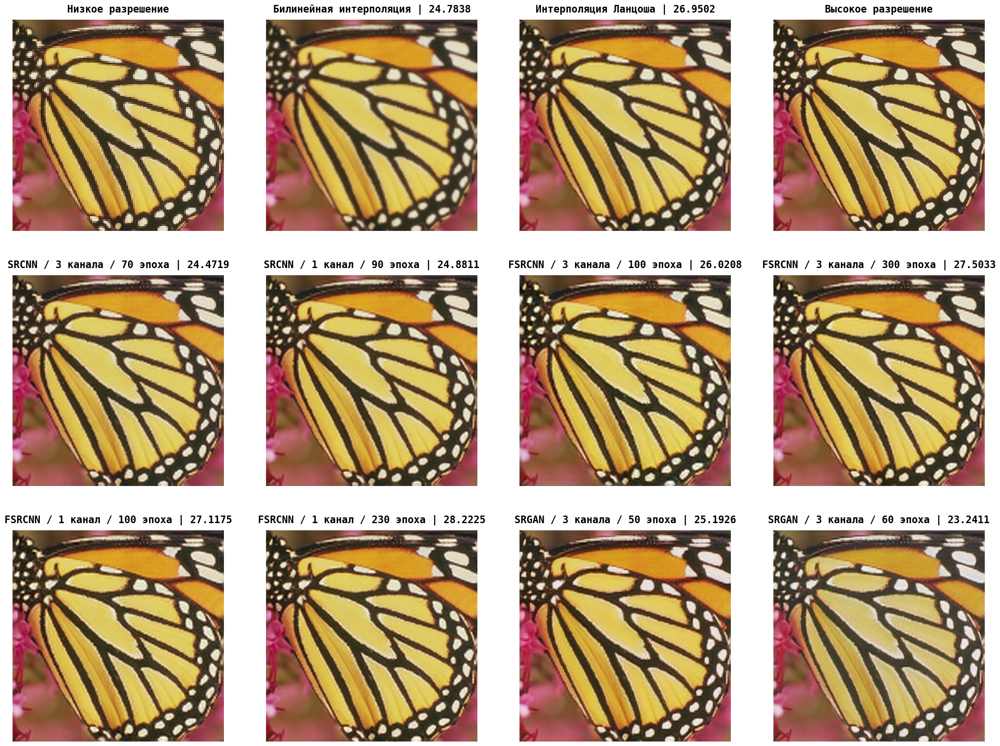

In [73]:
summary.summary_picture()

Или, уменьшив обзор до определённого квадрата $32\text{x}32$:

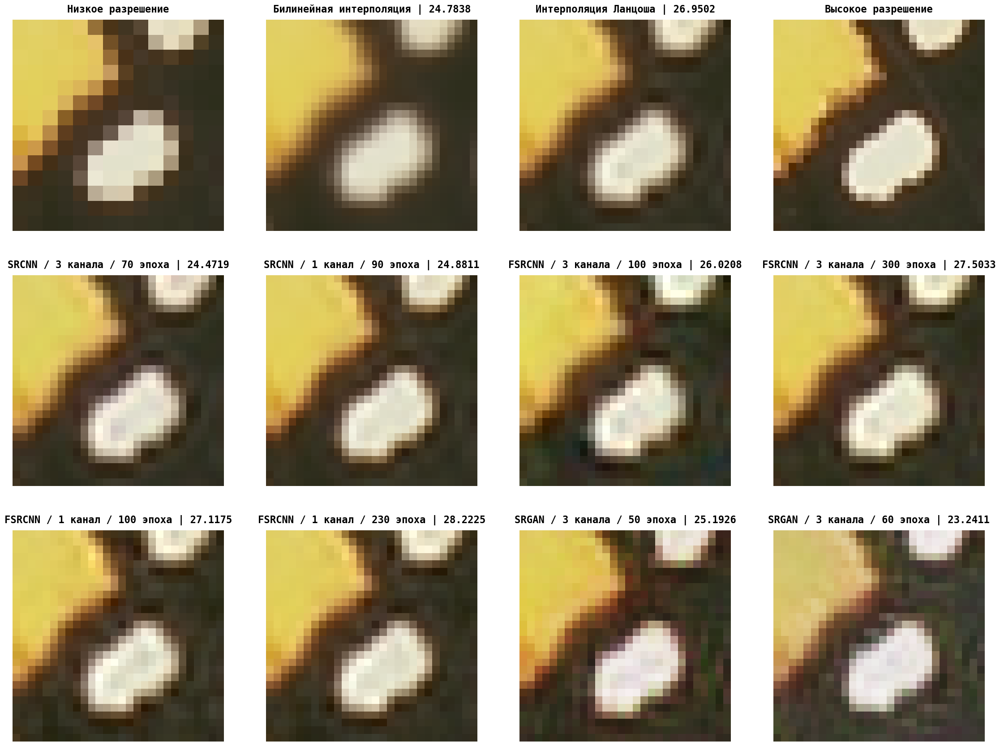

In [74]:
summary.summary_picture(cropx=(196, 224), cropy=(196, 224))

<style>
h1:after,
h2:after,
h3:after,
h4:after {
    position: absolute;
    content: "";
    left: 0;
    top: 0;
    bottom: 0;
    width: 5px;
    border-radius: 5px;
    box-shadow:
        inset 0 1px 1px rgba(0,0,0,0.5),
        0 1px 1px rgba(255,255,255,0.3);
}
 
h1:after { background: #aaf683; left: 0; padding: 0 0 0 10px;}
h2:after { background: #aaf683; left: 10px; padding: 0 0 0 5px;}
h3:after { background: #aaf683; left: 20px;}
h4:after { background: #aaf683; left: 30px;}
 
h1 {
    font-size: 36px;
    line-height: 40px;
    padding: 0 0 0 25px;
    margin: 1em 0 .6em 0;
    font-weight: normal;
    
    font-family: 'Hammersmith One', sans-serif;
    text-shadow: 1px 1px 2px rgba(0,0,0,0.4);
    position: relative;
}
 
h2 {
    margin: 1em 0 .6em 0;
    padding: 0 0 0 35px;
    font-weight: normal;
    
    font-family: 'Hammersmith One', sans-serif;
    text-shadow: 1px 1px 2px rgba(0,0,0,0.4);
    position: relative;
    font-size: 30px;
    line-height: 36px;
}
 
h3 {
    margin: 1em 0 .6em 0;
    padding: 0 0 0 40px;
    font-weight: normal;
    
    font-family: 'Hammersmith One', sans-serif;
    text-shadow: 1px 1px 2px rgba(0,0,0,0.4);
    position: relative;
    font-size: 24px;
    line-height: 32px;
    font-family: 'Questrial', sans-serif;
}
 
h4 {
    margin: 1em 0 .6em 0;
    padding: 0 0 0 50px;
    font-weight: normal;
    
    font-family: 'Hammersmith One', sans-serif;
    text-shadow: 1px 1px 2px rgba(0,0,0,0.4);
    position: relative;
    font-size: 18px;
    line-height: 28px;
    font-family: 'Questrial', sans-serif;
}
</style>

# <h1>Заключение</h1> <a class="anchor" id="conclusion"></a>

В данной работе были рассмотрены алгоритмы повышения качества изображений с помощью нейросетей:

- `SRCNN` как базовое решение представленной проблемы показал удовлетворительные результаты;
- `FSRCNN` как улучшение предыдущего метода представил наилучшие показатели;
- `SRGAN` как потенциально сильная модель, показавшая, к сожалению, наихудший результат.

Результаты моделей, основанных на свёрточных слоях, можно назвать положительными, так как они показали превосходство в качестве над алгоритмами интерполяции.

Также было показано, что разбиение на одноканальные изображения даёт прирост в метрике и лишь слабо сказывается на вычислительные затраты.

<style>
h1:after,
h2:after,
h3:after,
h4:after {
    position: absolute;
    content: "";
    left: 0;
    top: 0;
    bottom: 0;
    width: 5px;
    border-radius: 5px;
    box-shadow:
        inset 0 1px 1px rgba(0,0,0,0.5),
        0 1px 1px rgba(255,255,255,0.3);
}
 
h1:after { background: #aaf683; left: 0; padding: 0 0 0 10px;}
h2:after { background: #aaf683; left: 10px; padding: 0 0 0 5px;}
h3:after { background: #aaf683; left: 20px;}
h4:after { background: #aaf683; left: 30px;}
 
h1 {
    font-size: 36px;
    line-height: 40px;
    padding: 0 0 0 25px;
    margin: 1em 0 .6em 0;
    font-weight: normal;
    
    font-family: 'Hammersmith One', sans-serif;
    text-shadow: 1px 1px 2px rgba(0,0,0,0.4);
    position: relative;
}
 
h2 {
    margin: 1em 0 .6em 0;
    padding: 0 0 0 35px;
    font-weight: normal;
    
    font-family: 'Hammersmith One', sans-serif;
    text-shadow: 1px 1px 2px rgba(0,0,0,0.4);
    position: relative;
    font-size: 30px;
    line-height: 36px;
}
 
h3 {
    margin: 1em 0 .6em 0;
    padding: 0 0 0 40px;
    font-weight: normal;
    
    font-family: 'Hammersmith One', sans-serif;
    text-shadow: 1px 1px 2px rgba(0,0,0,0.4);
    position: relative;
    font-size: 24px;
    line-height: 32px;
    font-family: 'Questrial', sans-serif;
}
 
h4 {
    margin: 1em 0 .6em 0;
    padding: 0 0 0 50px;
    font-weight: normal;
    
    font-family: 'Hammersmith One', sans-serif;
    text-shadow: 1px 1px 2px rgba(0,0,0,0.4);
    position: relative;
    font-size: 18px;
    line-height: 28px;
    font-family: 'Questrial', sans-serif;
}
</style>

# <h1>Список источников</h1> <a class="anchor" id="references"></a>

- [Kaggle Image Super Resolution Dataset](https://www.kaggle.com/datasets/adityachandrasekhar/image-super-resolution/data)
- [Deep Learning for Image Super Resolution](https://arxiv.org/pdf/1902.06068)
- [Image Super Resolutiion: A Comprehensive Review](https://blog.paperspace.com/image-super-resolution/)
- [<svg width=15px style="color: red" role="img" viewBox="0 0 24 24" xmlns="http://www.w3.org/2000/svg"><title>PyTorch</title><path d="M12.005 0L4.952 7.053a9.865 9.865 0 000 14.022 9.866 9.866 0 0014.022 0c3.984-3.9 3.986-10.205.085-14.023l-1.744 1.743c2.904 2.905 2.904 7.634 0 10.538s-7.634 2.904-10.538 0-2.904-7.634 0-10.538l4.647-4.646.582-.665zm3.568 3.899a1.327 1.327 0 00-1.327 1.327 1.327 1.327 0 001.327 1.328A1.327 1.327 0 0016.9 5.226 1.327 1.327 0 0015.573 3.9z" fill="red"></path></svg> PyTorch](https://pytorch.org/)
- [SRCNN PyTorch implementation](https://github.com/Fivefold/SRCNN)
- [FSRCNN PyTorch implementation](https://github.com/Nhat-Thanh/FSRCNN-Pytorch)
- [SRGAN PyTorch implementetion](https://www.kaggle.com/code/minawagihsmikhael/srgan-image-super-resolution-pytorch/notebook)